In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile
import cv2
import pandas as pd
import difflib
import time
import plotly.plotly as py
import plotly.graph_objs as go
from skimage.measure import compare_ssim as ssim
from tqdm import tqdm_notebook

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

sys.path.insert(0, os.path.abspath(".."))
from utils import label_map_util
from utils import visualization_utils as vis_util

# MODEL_NAME = 'faster_rcnn_inception_resnet_v2_atrous_coco_11_06_2017'
MODEL_NAME = 'faster_rcnn_resnet101_coco_11_06_2017'

PATH_TO_CKPT = MODEL_NAME + '/frozen_inference_graph.pb'
PATH_TO_LABELS = os.path.join('data', 'mscoco_label_map.pbtxt')

NUM_CLASSES = 90

print ('loading model..')
detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')
print('model loaded')

label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

loading model..
model loaded


## Human Detection Process

In [2]:
def detection(path):
    points_objs = {}
    frame_objs = {}
    
    start = time.time()
    
    with detection_graph.as_default():
        with tf.Session(graph=detection_graph) as sess:
            skip = 0
            cap = cv2.VideoCapture(path)

            id_frame = 0
            id_center = 0

            while(True):
                ret, frame = cap.read()
                if cv2.waitKey(1) & 0xFF == ord('q'): break
                if(skip == 2):
                    skip = 0
                    image_np = np.array(frame)
                    if(image_np.shape == ()): break

                    print('Frame ID:', id_frame, '\tTime:', '{0:.2f}'.format(time.time()-start), 'seconds')
                    frame_objs[id_frame] = image_np
                    image_np_expanded = np.expand_dims(image_np, axis=0)


                    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
                    boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
                    scores = detection_graph.get_tensor_by_name('detection_scores:0')
                    classes = detection_graph.get_tensor_by_name('detection_classes:0')
                    num_detections = detection_graph.get_tensor_by_name('num_detections:0')

                    (boxes, scores, classes, num_detections) = sess.run([boxes, scores, classes, num_detections],
                        feed_dict={image_tensor: image_np_expanded})

                    boxes = np.squeeze(boxes)
                    classes = np.squeeze(classes).astype(np.int32)
                    scores = np.squeeze(scores)

                    count_boxes = 0
                    thresh = 0.7
                    max_boxes = 30

                    for i, c in enumerate(classes):
                        if (c == 1 and (scores[i] > thresh) and (count_boxes < max_boxes)):

                            im_height = image_np.shape[0]
                            im_width = image_np.shape[1]
                            
                            
                            ymin, xmin, ymax, xmax = boxes[i]
                            x_center, y_center = (xmin+xmax)/2, (ymin+ymax)/2

                            points_objs[id_center] = {
                                'frame': id_frame,
                                'center': [x_center, y_center],
                                'bbox': [ymin, xmin, ymax, xmax],
                                'score': scores[i]
                            }
                            (left, right, top, bottom) = (int(xmin*im_width),  int(xmax*im_width),
                                                          int(ymin*im_height), int(ymax*im_height))

                            (xmin, xmax, ymin, ymax) = (left, right, top, bottom)
                            points_objs[id_center]['bbox_real'] =  [xmin, xmax, ymin, ymax]

                            id_center += 1
                            count_boxes += 1

                    id_frame += 1

                skip+=1

            cap.release()
            cv2.destroyAllWindows()

        return points_objs, frame_objs

## Create Graph from Point Maps

In [3]:
def create_graph(points_objs, frame_objs, df_points, distance_thresh = 0.05):
    graphs = {-1:[]}
    for i in points_objs:
        graphs[i] = []

    df_prev = df_points.loc[df_points['frame'] == 0]
    for i,row in df_prev.iterrows():
        graphs[-1].append(i)

    for k in range(len(frame_objs)-1):
        df_prev = df_points.loc[df_points['frame'] == k]
        df_curr = df_points.loc[df_points['frame'] == k+1]

        for i, row_i in df_curr.iterrows():
            curr_point = np.array(row_i['center'])
            Min = 9999999.0
            ind = -1
            for j, row_j in df_prev.iterrows():
                prev_point = np.array(row_j['center'])
                dist = np.linalg.norm(prev_point - curr_point)
                if(dist < Min):
                    Min = dist
                    ind = j
            Sim = 1  
#             Sim = compare_images(i, ind, points_objs, frame_objs, df_points)

            if(Min < distance_thresh and Sim > 0.8):
                graphs[ind].append(i)
            else:
                graphs[-1].append(i)

    # Add End point
    for i in points_objs:
        if(len(graphs[i]) == 0):
            graphs[i].append(-99)
    
    print('Graphs:',len(graphs),'nodes')
    return graphs

In [4]:
def mae(img_A, img_B):
    err = np.sum(np.abs(img_A.astype("float")-img_B.astype("float")))
    err /= float(img_A.shape[0] * img_A.shape[1] * img_A.shape[2])
    err /= 255
    return 1.0-err

def compare_images(ind_A, ind_B, points_objs, frame_objs, df_points):
    with tf.Session() as sess:
        obj = df_points.loc[ind_A]
        xmin, xmax, ymin, ymax = obj['bbox_real']
        img_A = tf.image.crop_to_bounding_box(frame_objs[obj['frame']], ymin, xmin, ymax-ymin, xmax-xmin)
        img_A = np.array(sess.run(img_A))

        obj = df_points.loc[ind_B]
        xmin, xmax, ymin, ymax = obj['bbox_real']
        img_B = tf.image.crop_to_bounding_box(frame_objs[obj['frame']], ymin, xmin, ymax-ymin, xmax-xmin)
        img_B = np.array(sess.run(img_B))

        img_A = cv2.resize(img_A, (200, 500))
        img_B = cv2.resize(img_B, (200, 500))

        m = mae(img_A, img_B)
        return m
#         s = ssim(img_A, img_B, multichannel=True)
#         avg = s*0.6 + m*0.4
        
#         return avg

## Find All Posible Paths

In [5]:
def find_all_paths(graph, start, end, path=[]):
    path = path + [start]
    if start == end:
        return [path]
    if start not in graph:
        return []
    paths = []
    for node in graph[start]:
        if node not in path:
            newpaths = find_all_paths(graph, node, end, path)
            for newpath in newpaths:
                paths.append(newpath)
    return paths

In [6]:
def graph_paths(graphs):
    paths = (find_all_paths(graphs, -1, -99))
#     for path in paths:
#         print(path)
    print('Total path:', len(paths))
    
    to_removes = []
    removed = 0
    for i in range(len(paths)-1):
        sm = difflib.SequenceMatcher(None, paths[i], paths[i+1])
        if(sm.ratio() > 0.7):
            to_removes.append(paths[i+1])
#         print(i,i-1,sm.ratio())
    print('Removed:', len(to_removes))

    for to_remove in to_removes:
        paths.remove(to_remove)
        
    return paths

## Visualize Bounding Boxes

In [7]:
def visualize_all(paths, df_points, directory):
    if not os.path.exists(os.path.join(directory, 'all_output')):
        os.makedirs(directory)
    with tf.Session() as sess:
         for path in paths:
            for ind in path[1:len(path)-1]:
                print(ind, 'score:', df_points.loc[ind]['score'])
                obj = df_points.loc[ind]
                xmin, xmax, ymin, ymax = obj['bbox_real']
                cropped_image = tf.image.crop_to_bounding_box(frame_objs[obj['frame']], ymin, xmin, ymax-ymin, xmax-xmin)
                cropped_image = np.array(sess.run(cropped_image))
                cropped_image = cropped_image[:,:,::-1]
                plt.imshow(cropped_image)
                plt.axis('off')
                plt.savefig(os.path.join(directory, 'all_output', str(ind)+'.png'), bbox_inches='tight', pad_inches = 0)
                plt.show()
                plt.show()
            print('======================================================================================')

In [9]:
def visualize_selected(paths, df_points, directory, continuous=3):
    os.makedirs(os.path.join(directory, 'output'), exist_ok=True)

    inds = []
    duplicates = []
    tmp_boxes = []
    tmp_scores = []
    for path in paths:
        
        inds_path = path[1:len(path)-1]
        if(len(inds_path) < continuous): continue
            
        for ind in inds_path:
            if ind not in duplicates:
                inds.append(ind)
                tmp_boxes.append(df_points.loc[ind]['bbox'])
                tmp_scores.append(df_points.loc[ind]['score'])
                break
        duplicates += path
        duplicates = list(set(duplicates))
    inds = np.array(inds)
    print('Total Objects:', len(inds))

    nms = None
    with tf.Session() as sess:    
        nms = sess.run(tf.image.non_max_suppression( tmp_boxes, tmp_scores, max_output_size = len(inds), iou_threshold = 0.6))

        inds = inds[nms]
        print(inds)
        print(len(inds))
        
        for ind in inds:
            print('ID:', ind, '\tscore:', df_points.loc[ind]['score'])
            obj = df_points.loc[ind]
            xmin, xmax, ymin, ymax = obj['bbox_real']
            cropped_image = tf.image.crop_to_bounding_box(frame_objs[obj['frame']], ymin, xmin, ymax-ymin, xmax-xmin)
            cropped_image = np.array(sess.run(cropped_image))
            plt.imshow( cropped_image[:,:,::-1])
            plt.axis('off')
            plt.savefig(os.path.join(directory, 'output', str(ind)+'.png'), bbox_inches='tight', pad_inches = 0)
            plt.show()

## Testing

In [10]:
points_objs, frame_objs = detection(path='../data/3_BEST/3_BEST.mp4')
df_points = pd.DataFrame.from_dict(points_objs, orient='index')

Frame ID: 0 	Time: 0.39 seconds
Frame ID: 1 	Time: 13.35 seconds
Frame ID: 2 	Time: 14.78 seconds
Frame ID: 3 	Time: 16.21 seconds
Frame ID: 4 	Time: 17.63 seconds
Frame ID: 5 	Time: 19.02 seconds
Frame ID: 6 	Time: 20.45 seconds
Frame ID: 7 	Time: 21.91 seconds
Frame ID: 8 	Time: 23.27 seconds
Frame ID: 9 	Time: 24.69 seconds
Frame ID: 10 	Time: 26.08 seconds
Frame ID: 11 	Time: 27.45 seconds
Frame ID: 12 	Time: 28.92 seconds
Frame ID: 13 	Time: 30.39 seconds
Frame ID: 14 	Time: 31.84 seconds
Frame ID: 15 	Time: 33.33 seconds
Frame ID: 16 	Time: 34.71 seconds
Frame ID: 17 	Time: 36.09 seconds
Frame ID: 18 	Time: 37.54 seconds
Frame ID: 19 	Time: 38.95 seconds
Frame ID: 20 	Time: 40.62 seconds
Frame ID: 21 	Time: 42.16 seconds
Frame ID: 22 	Time: 43.58 seconds
Frame ID: 23 	Time: 44.96 seconds
Frame ID: 24 	Time: 46.32 seconds
Frame ID: 25 	Time: 47.68 seconds
Frame ID: 26 	Time: 49.03 seconds
Frame ID: 27 	Time: 50.40 seconds
Frame ID: 28 	Time: 51.77 seconds
Frame ID: 29 	Time: 53.14

In [11]:
graphs = create_graph(points_objs, frame_objs, df_points, distance_thresh = 0.03)
paths = graph_paths(graphs)
for path in paths:
    print(path)

Graphs: 691 nodes
Total path: 411
Removed: 0
[-1, 0, 15, 23, 39, -99]
[-1, 1, -99]
[-1, 2, -99]
[-1, 3, -99]
[-1, 4, 17, 29, -99]
[-1, 5, -99]
[-1, 6, 19, 38, -99]
[-1, 7, -99]
[-1, 8, -99]
[-1, 9, -99]
[-1, 10, -99]
[-1, 11, -99]
[-1, 12, -99]
[-1, 13, 24, 42, -99]
[-1, 14, -99]
[-1, 16, -99]
[-1, 18, 31, -99]
[-1, 20, 30, -99]
[-1, 21, 28, 41, -99]
[-1, 22, -99]
[-1, 25, -99]
[-1, 26, -99]
[-1, 27, -99]
[-1, 32, -99]
[-1, 33, -99]
[-1, 34, 50, -99]
[-1, 35, 47, 63, -99]
[-1, 36, -99]
[-1, 37, -99]
[-1, 40, -99]
[-1, 43, -99]
[-1, 44, -99]
[-1, 45, -99]
[-1, 46, 65, 80, -99]
[-1, 48, -99]
[-1, 49, -99]
[-1, 51, 71, -99]
[-1, 52, 70, -99]
[-1, 53, -99]
[-1, 54, 73, 87, 103, 117, 128, -99]
[-1, 55, 74, -99]
[-1, 56, 76, 90, -99]
[-1, 57, 72, 88, 106, 119, -99]
[-1, 58, 75, 92, -99]
[-1, 59, 77, -99]
[-1, 60, 81, -99]
[-1, 61, 79, 96, -99]
[-1, 62, -99]
[-1, 64, 78, -99]
[-1, 66, -99]
[-1, 67, -99]
[-1, 68, -99]
[-1, 69, -99]
[-1, 82, -99]
[-1, 83, -99]
[-1, 84, -99]
[-1, 85, -99]
[-1, 8

In [14]:
data = []
for path in paths:

    inds = path[1:len(path)-1]
    if(len(inds) <= 2):
        continue

    df = df_points.loc[inds]
    centers = df['center'].values
    Xs, Ys = [], []
    for center in centers:
        x, y = center
        Xs.append(x)
        Ys.append(y)
    Zs = df['frame']

    trace = go.Scatter3d(
        x=Xs,
        y=Ys,
        z=Zs,
        mode='markers',
        marker=dict(
            size=7,
            opacity=0.8
        )
    )
    data.append(trace)

layout = go.Layout(
    height=1000,
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    )
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='human_detection')

In [12]:
Xs, Ys, Zs = [], [], []
for ind in points_objs:
    x, y = points_objs[ind]['center'] 
    z = points_objs[ind]['frame']
    Xs.append(x)
    Ys.append(y)
    Zs.append(z)
    
trace1 = go.Scatter3d(
    x=Xs,
    y=Ys,
    z=Zs,
    mode='markers',
    marker=dict(
        size=7,
        color=Zs,                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)

data = [trace1]
layout = go.Layout(
    height=1000,
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    )
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='human_detection')

Total Objects: 55
[ 13 501   0  54 373 569 359 146 322   4 504 385 399 417   6 618 208  56
  57 209 348 179  58 403 508 645 418  46 170 535 609  61 212 480  95 548
  35 467 648 286]
40
ID: 13 	score: 0.99820792675


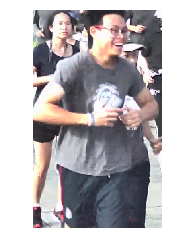

ID: 501 	score: 0.997142732143


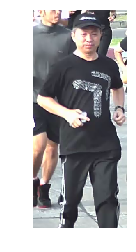

ID: 0 	score: 0.996528446674


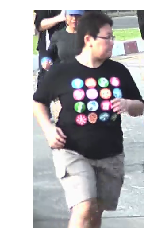

ID: 54 	score: 0.995494365692


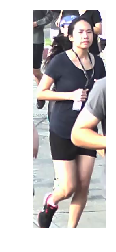

ID: 373 	score: 0.995266079903


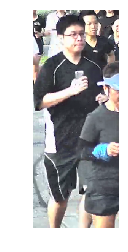

ID: 569 	score: 0.994748651981


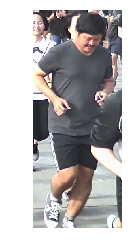

ID: 359 	score: 0.994336545467


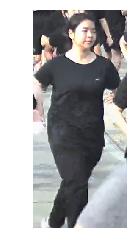

ID: 146 	score: 0.994332551956


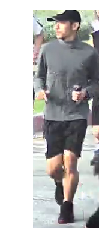

ID: 322 	score: 0.993432998657


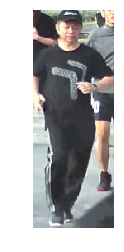

ID: 4 	score: 0.9888702631


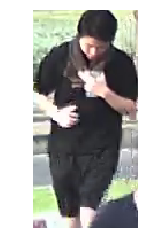

ID: 504 	score: 0.988548278809


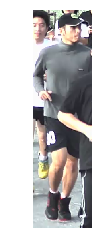

ID: 385 	score: 0.986420869827


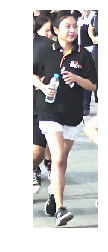

ID: 399 	score: 0.985156655312


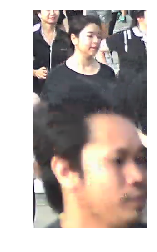

ID: 417 	score: 0.975495100021


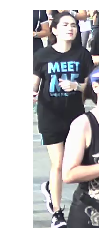

ID: 6 	score: 0.971204280853


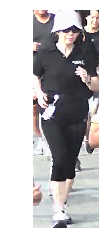

ID: 618 	score: 0.971117913723


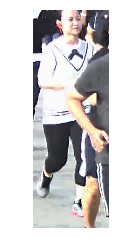

ID: 208 	score: 0.969827473164


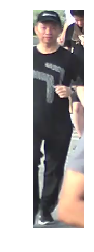

ID: 56 	score: 0.963803470135


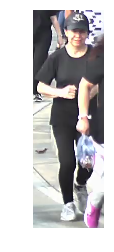

ID: 57 	score: 0.963360846043


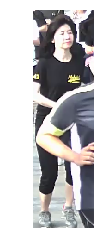

ID: 209 	score: 0.962660253048


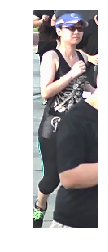

ID: 348 	score: 0.961080014706


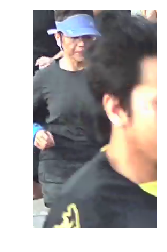

ID: 179 	score: 0.960533618927


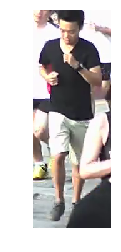

ID: 58 	score: 0.955271303654


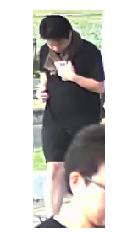

ID: 403 	score: 0.954079568386


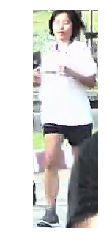

ID: 508 	score: 0.952675163746


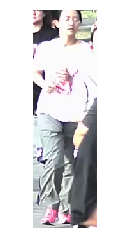

ID: 645 	score: 0.951271593571


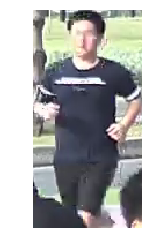

ID: 418 	score: 0.943780481815


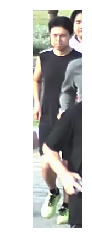

ID: 46 	score: 0.927980601788


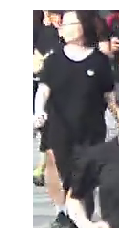

ID: 170 	score: 0.922323524952


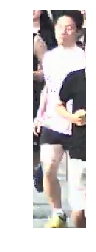

ID: 535 	score: 0.890850663185


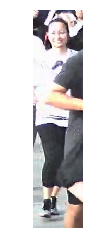

ID: 609 	score: 0.885124206543


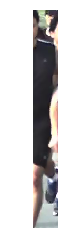

ID: 61 	score: 0.84261906147


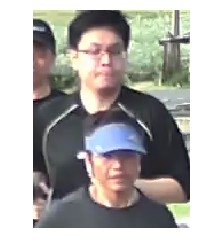

ID: 212 	score: 0.829419016838


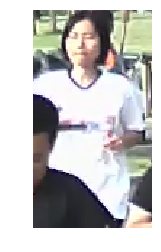

ID: 480 	score: 0.810715258121


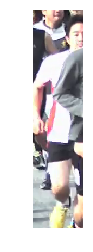

ID: 95 	score: 0.806730270386


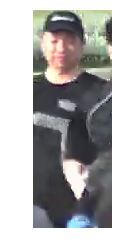

ID: 548 	score: 0.779350817204


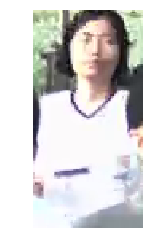

ID: 35 	score: 0.774866342545


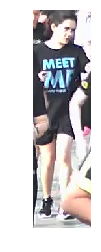

ID: 467 	score: 0.766795814037


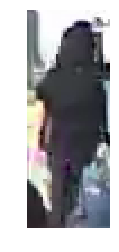

ID: 648 	score: 0.747224330902


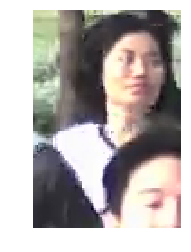

ID: 286 	score: 0.734292328358


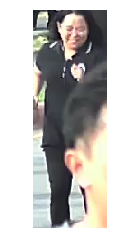

In [16]:
visualize_selected(paths, df_points, directory = '../data/5_BEST/')

## Testing #2

In [9]:
points_objs, frame_objs = detection(path='../data/5_BEST/5_BEST.mp4')
df_points = pd.DataFrame.from_dict(points_objs, orient='index')

graphs = create_graph(points_objs, frame_objs, df_points)
print('Graphs:',len(graphs),'nodes')

paths = graph_paths(graphs)

Frame ID: 0 	Time: 0.36 seconds
Frame ID: 1 	Time: 11.89 seconds
Frame ID: 2 	Time: 13.42 seconds
Frame ID: 3 	Time: 14.94 seconds
Frame ID: 4 	Time: 16.39 seconds
Frame ID: 5 	Time: 17.77 seconds
Frame ID: 6 	Time: 19.40 seconds
Frame ID: 7 	Time: 20.92 seconds
Frame ID: 8 	Time: 22.32 seconds
Frame ID: 9 	Time: 23.74 seconds
Frame ID: 10 	Time: 25.12 seconds
Frame ID: 11 	Time: 26.50 seconds
Frame ID: 12 	Time: 27.88 seconds
Frame ID: 13 	Time: 29.25 seconds
Frame ID: 14 	Time: 30.61 seconds
Frame ID: 15 	Time: 31.98 seconds
Frame ID: 16 	Time: 33.36 seconds
Frame ID: 17 	Time: 34.73 seconds
Frame ID: 18 	Time: 36.12 seconds
Graphs: 95 nodes
[-1, 0, 5, 10, 16, 21, 26, 28, 37, 43, 48, 52, 56, 61, 67, 72, 77, 81, 85, 89, -99]
[-1, 1, 6, 11, 15, 22, 24, 31, 35, 41, 46, 53, 57, 63, 66, 71, 75, 79, 84, 91, -99]
[-1, 2, 7, 12, 18, 20, 25, 30, 34, 40, 45, 51, 58, 62, 68, 73, 76, 80, 86, 90, -99]
[-1, 2, 7, 12, 18, 20, 25, 30, 39, -99]
[-1, 3, 8, 13, 17, 23, 27, 29, 36, 42, 47, 54, 59, 65, 7

0 score: 0.998854756355


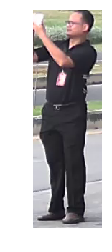

5 score: 0.998843431473


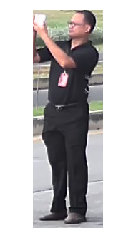

10 score: 0.999139428139


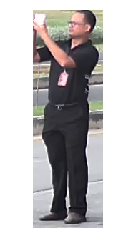

16 score: 0.999088168144


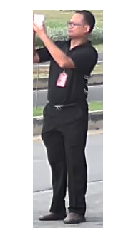

21 score: 0.999068558216


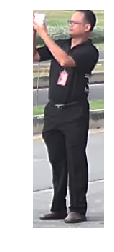

26 score: 0.998411178589


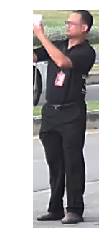

28 score: 0.998769581318


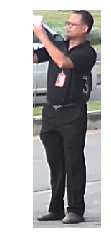

37 score: 0.991268754005


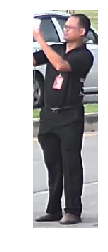

43 score: 0.994977891445


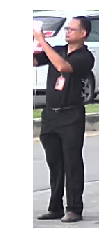

48 score: 0.981982588768


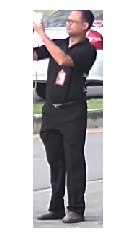

52 score: 0.998418569565


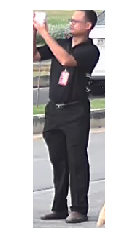

56 score: 0.998995125294


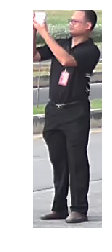

61 score: 0.998968362808


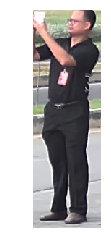

67 score: 0.999030351639


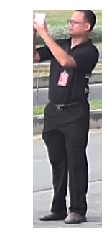

72 score: 0.997732877731


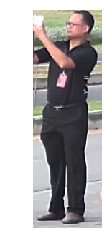

77 score: 0.996805548668


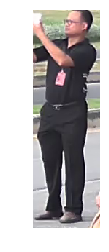

81 score: 0.997229874134


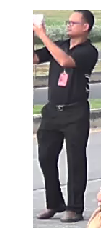

85 score: 0.998211741447


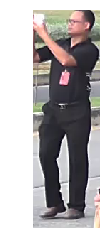

89 score: 0.999080657959


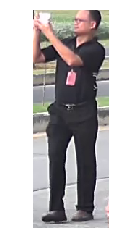

1 score: 0.998422980309


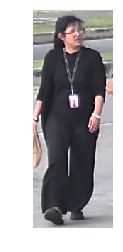

6 score: 0.998549878597


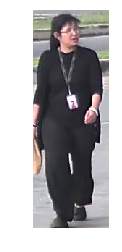

11 score: 0.998980224133


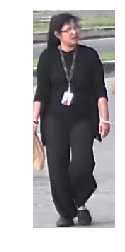

15 score: 0.999357044697


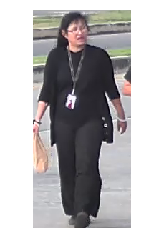

22 score: 0.998812317848


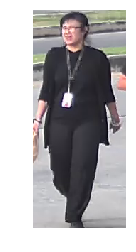

24 score: 0.999411702156


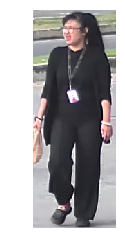

31 score: 0.996697545052


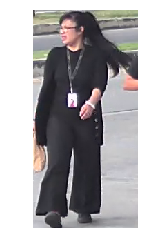

35 score: 0.9985871315


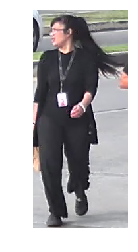

41 score: 0.999191939831


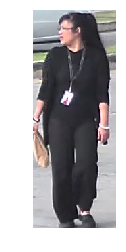

46 score: 0.996600210667


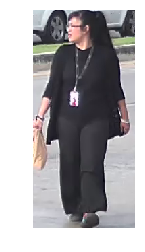

53 score: 0.998181819916


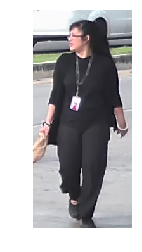

57 score: 0.998410820961


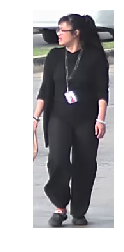

63 score: 0.997789502144


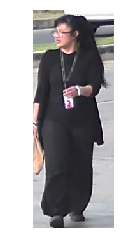

66 score: 0.999246478081


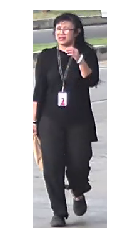

71 score: 0.999274909496


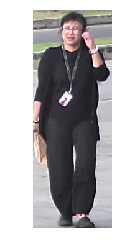

75 score: 0.999199211597


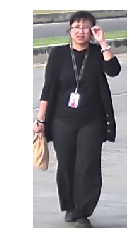

79 score: 0.999262034893


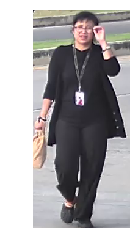

84 score: 0.99922311306


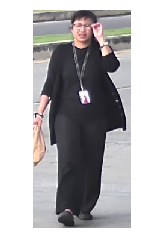

91 score: 0.997850298882


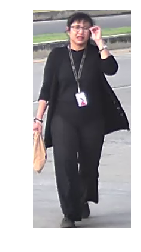

2 score: 0.998280286789


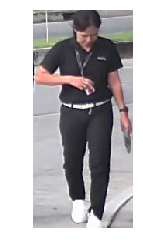

7 score: 0.998334944248


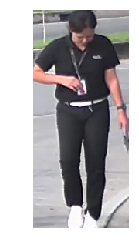

12 score: 0.998786270618


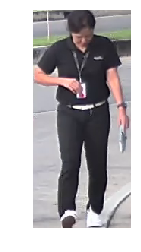

18 score: 0.998214364052


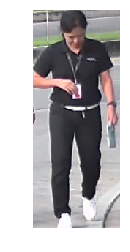

20 score: 0.99929857254


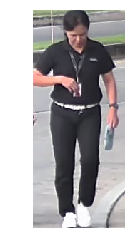

25 score: 0.999329924583


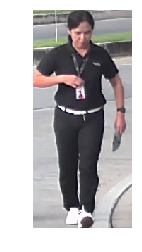

30 score: 0.997886955738


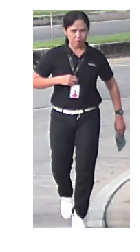

34 score: 0.998943984509


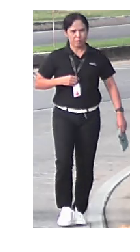

40 score: 0.999233603477


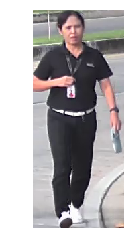

45 score: 0.998741686344


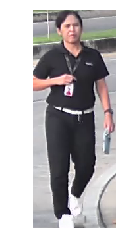

51 score: 0.998704195023


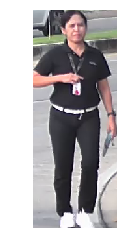

58 score: 0.997414708138


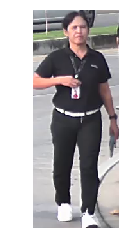

62 score: 0.998243331909


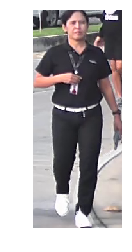

68 score: 0.995359241962


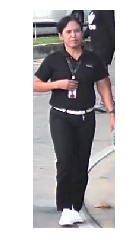

73 score: 0.993551135063


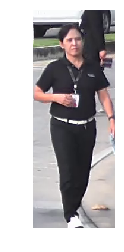

76 score: 0.998104333878


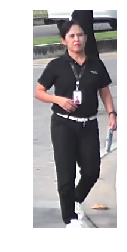

80 score: 0.997851252556


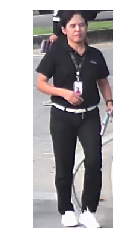

86 score: 0.998109102249


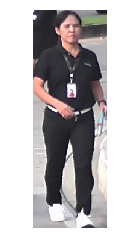

90 score: 0.998040735722


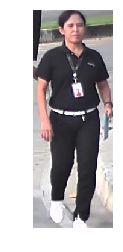

2 score: 0.998280286789


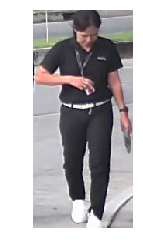

7 score: 0.998334944248


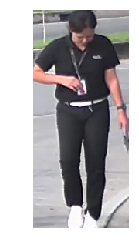

12 score: 0.998786270618


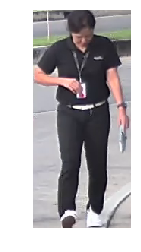

18 score: 0.998214364052


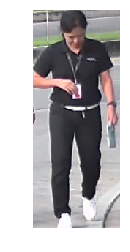

20 score: 0.99929857254


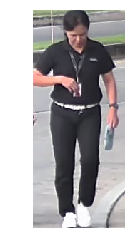

25 score: 0.999329924583


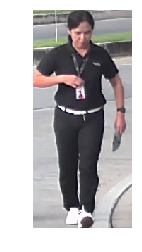

30 score: 0.997886955738


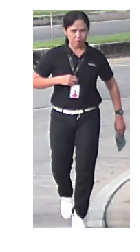

39 score: 0.790339648724


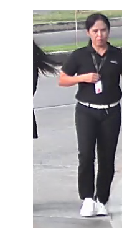

3 score: 0.988120794296


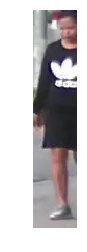

8 score: 0.996770501137


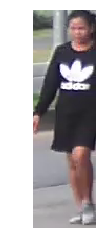

13 score: 0.997329831123


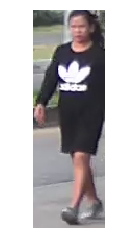

17 score: 0.998845338821


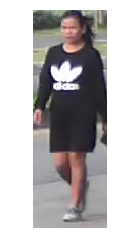

23 score: 0.998138070107


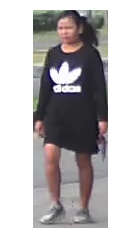

27 score: 0.998153865337


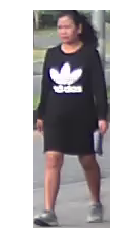

29 score: 0.99813336134


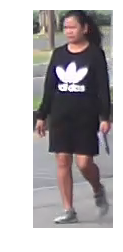

36 score: 0.997521936893


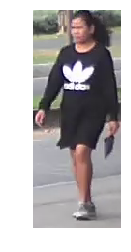

42 score: 0.99860137701


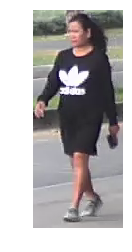

47 score: 0.995606005192


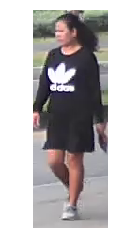

54 score: 0.993390202522


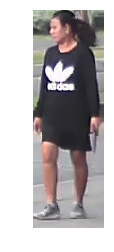

59 score: 0.994764089584


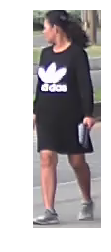

65 score: 0.961034536362


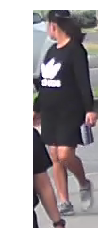

70 score: 0.723587870598


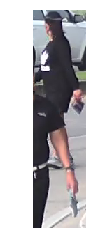

4 score: 0.950058400631


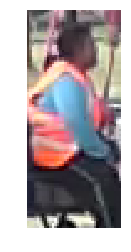

9 score: 0.953456640244


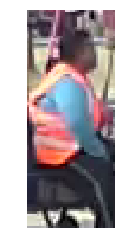

14 score: 0.968024373055


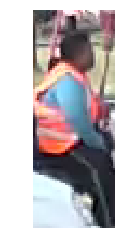

19 score: 0.820777833462


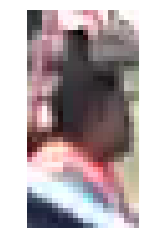

32 score: 0.842427492142


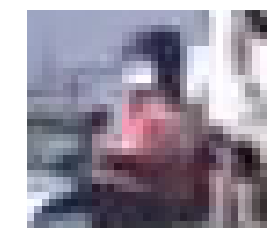

33 score: 0.712385296822


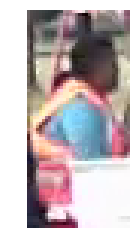

38 score: 0.941755712032


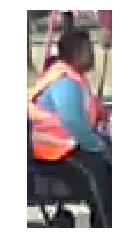

44 score: 0.974745810032


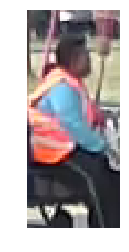

49 score: 0.933550477028


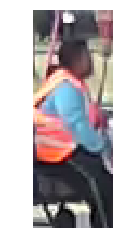

55 score: 0.949227154255


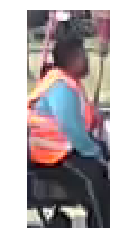

60 score: 0.976455271244


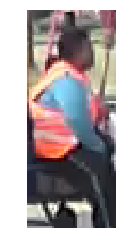

64 score: 0.969140529633


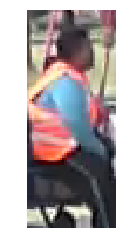

69 score: 0.958380401134


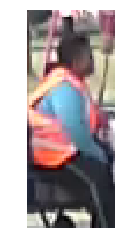

74 score: 0.96360129118


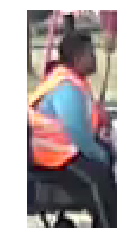

78 score: 0.94691067934


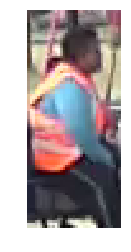

82 score: 0.957637786865


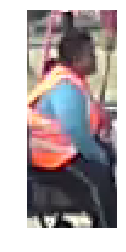

88 score: 0.972963273525


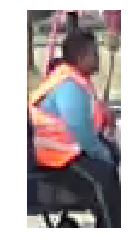

93 score: 0.973059773445


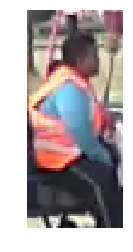

50 score: 0.86581838131


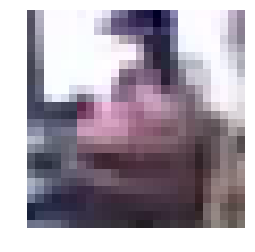

83 score: 0.724771022797


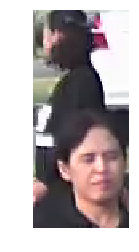

87 score: 0.985365092754


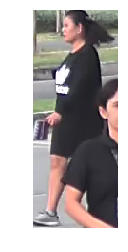

92 score: 0.995920300484


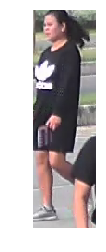

In [13]:
visualize_all(paths, df_points, directory='../data/5_BEST/')

Total Objects: 10
[ 0  1  2  3  4 50 32 39 83]
9
ID: 0 	score: 0.998854756355


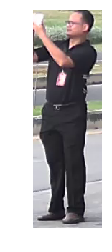

ID: 1 	score: 0.998422980309


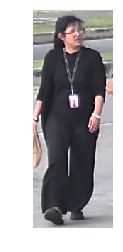

ID: 2 	score: 0.998280286789


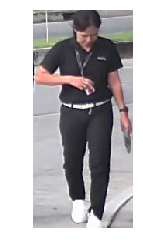

ID: 3 	score: 0.988120794296


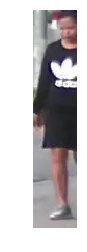

ID: 4 	score: 0.950058400631


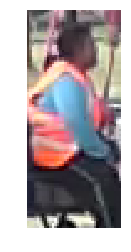

ID: 50 	score: 0.86581838131


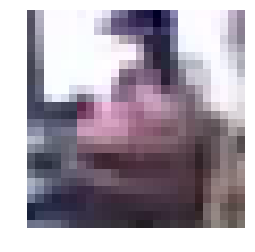

ID: 32 	score: 0.842427492142


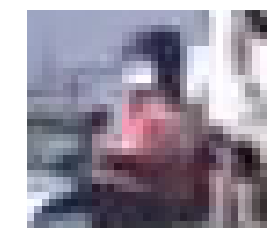

ID: 39 	score: 0.790339648724


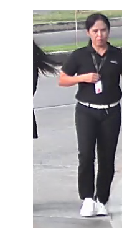

ID: 83 	score: 0.724771022797


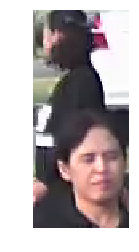

In [25]:
visualize_selected(paths, df_points, directory = '../data/5_BEST/')

## Testing #3

In [24]:
points_objs, frame_objs = detection(path='../data/5_BEST/5_BEST.mp4')

Frame ID: 0 	Time: 0.09 seconds
Frame ID: 1 	Time: 6.76 seconds
Frame ID: 2 	Time: 8.09 seconds
Frame ID: 3 	Time: 9.44 seconds
Frame ID: 4 	Time: 10.77 seconds
Frame ID: 5 	Time: 12.10 seconds
Frame ID: 6 	Time: 13.43 seconds
Frame ID: 7 	Time: 14.76 seconds
Frame ID: 8 	Time: 16.10 seconds
Frame ID: 9 	Time: 17.43 seconds
Frame ID: 10 	Time: 18.76 seconds
Frame ID: 11 	Time: 20.11 seconds
Frame ID: 12 	Time: 21.44 seconds
Frame ID: 13 	Time: 22.77 seconds
Frame ID: 14 	Time: 24.10 seconds
Frame ID: 15 	Time: 25.43 seconds
Frame ID: 16 	Time: 26.76 seconds
Frame ID: 17 	Time: 28.10 seconds
Frame ID: 18 	Time: 29.43 seconds
Frame ID: 19 	Time: 30.77 seconds
Frame ID: 20 	Time: 32.11 seconds
Frame ID: 21 	Time: 33.45 seconds
Frame ID: 22 	Time: 34.78 seconds
Frame ID: 23 	Time: 36.11 seconds
Frame ID: 24 	Time: 37.45 seconds
Frame ID: 25 	Time: 38.79 seconds
Frame ID: 26 	Time: 40.12 seconds
Frame ID: 27 	Time: 41.46 seconds
Frame ID: 28 	Time: 42.93 seconds
Frame ID: 29 	Time: 44.30 se

In [31]:
df_points = pd.DataFrame.from_dict(points_objs, orient='index')

graphs = create_graph(points_objs, frame_objs, df_points)
print('Graphs:',len(graphs),'nodes')

paths = graph_paths(graphs)

Graphs: 484 nodes
[-1, 0, 6, 10, 15, 21, 27, 32, 37, 42, 46, 52, 55, 61, 66, 71, 76, 80, 86, 90, 95, 100, 105, 109, 116, 122, 124, 129, 133, 137, 141, 146, 150, 156, 161, 168, 173, 179, 185, 189, 193, 199, 205, 209, 214, 219, 224, 229, 234, 239, 245, 251, 256, 261, 266, 272, 277, 282, 287, 292, 298, 303, 308, 312, 318, 324, 328, 333, 338, 342, 347, 353, 357, 361, 365, 369, 373, 377, 381, 385, 389, 393, 398, 403, 408, 413, 418, 423, 428, 433, 438, 443, 448, 454, 459, 465, 470, 475, 480, -99]
[-1, 1, 7, 11, 16, 20, 25, 30, 35, 40, 45, 50, 56, 60, 65, 70, 75, 81, 85, 91, 96, 102, 106, 111, 115, 121, 125, 128, 132, 138, 143, 147, 151, 154, 159, 165, 174, 178, 184, 190, 195, 201, 206, 211, 216, 221, 226, 231, 236, 241, 247, 253, 257, 262, 267, 271, 275, 280, 285, 291, 297, 302, 307, 313, 317, 322, 327, 332, 337, 343, 348, 352, 358, 362, 366, 370, 374, 378, 382, 387, 391, 395, 400, 405, 410, 415, 419, 425, 429, 434, 439, 444, 449, 453, 458, 463, 468, 473, 478, -99]
[-1, 2, 5, 12, 17, 22, 26,

0 score: 0.999021172523


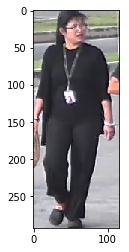

6 score: 0.998955011368


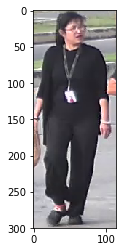

10 score: 0.999092102051


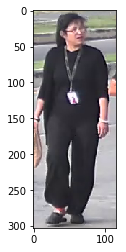

15 score: 0.998859167099


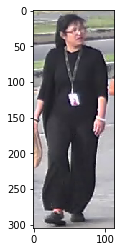

21 score: 0.998422980309


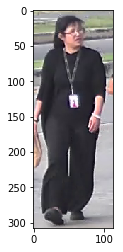

27 score: 0.997928142548


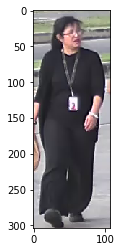

32 score: 0.997567176819


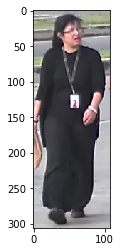

37 score: 0.99715000391


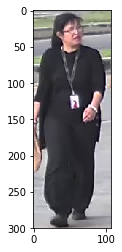

42 score: 0.998066008091


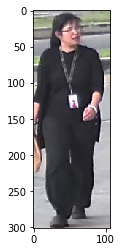

46 score: 0.998549878597


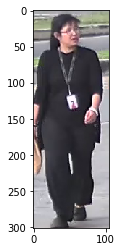

52 score: 0.998509705067


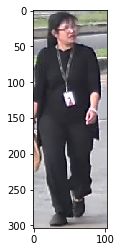

55 score: 0.998947203159


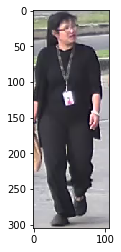

61 score: 0.998975515366


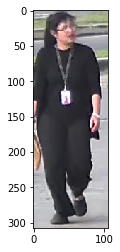

66 score: 0.998971104622


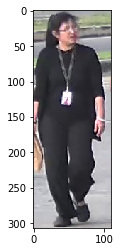

71 score: 0.998980224133


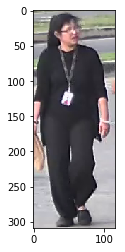

76 score: 0.99883633852


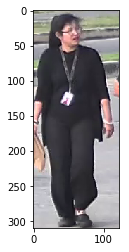

80 score: 0.999104201794


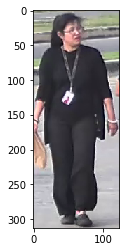

86 score: 0.998729646206


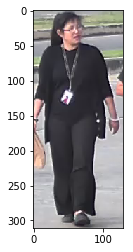

90 score: 0.999187886715


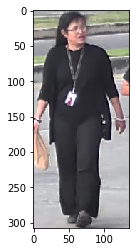

95 score: 0.999357044697


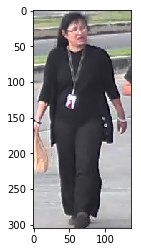

100 score: 0.99944883585


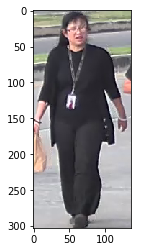

105 score: 0.999453246593


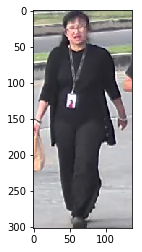

109 score: 0.999293804169


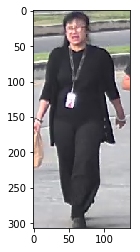

116 score: 0.998987495899


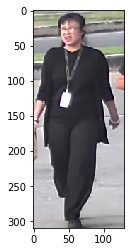

122 score: 0.998812317848


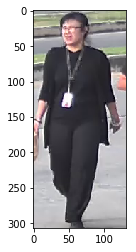

124 score: 0.999270021915


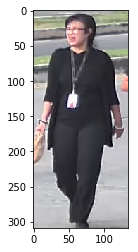

129 score: 0.99910068512


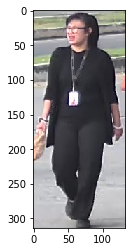

133 score: 0.999074220657


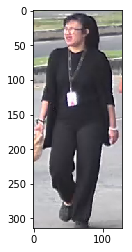

137 score: 0.999197423458


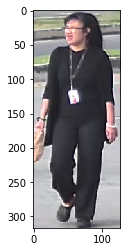

141 score: 0.999411702156


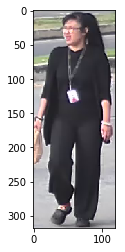

146 score: 0.998882353306


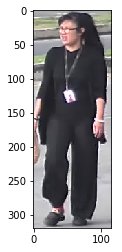

150 score: 0.9986525774


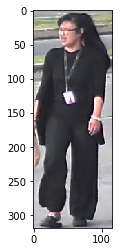

156 score: 0.998344302177


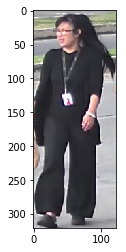

161 score: 0.997999846935


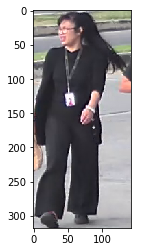

168 score: 0.996697545052


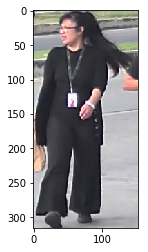

173 score: 0.99708789587


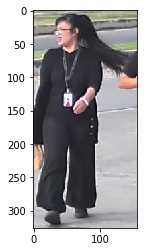

179 score: 0.997029781342


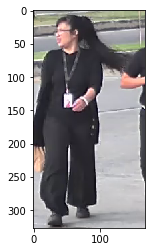

185 score: 0.994422495365


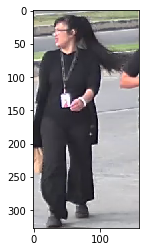

189 score: 0.996654272079


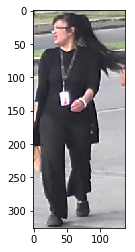

193 score: 0.9985871315


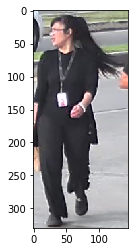

199 score: 0.997786283493


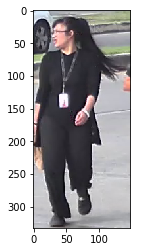

205 score: 0.997526347637


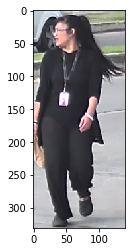

209 score: 0.997580528259


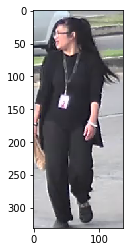

214 score: 0.99853014946


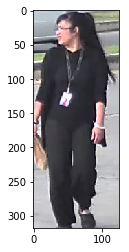

219 score: 0.999191939831


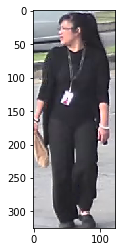

224 score: 0.998915195465


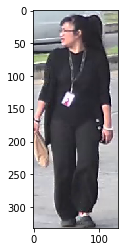

229 score: 0.998608410358


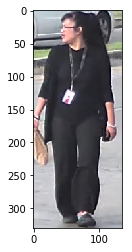

234 score: 0.998037993908


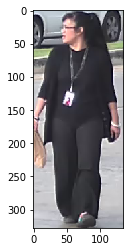

239 score: 0.998122036457


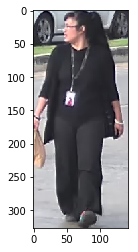

245 score: 0.996600210667


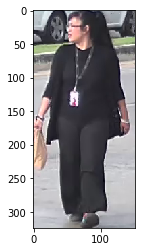

251 score: 0.997873187065


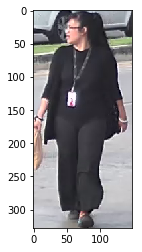

256 score: 0.998439729214


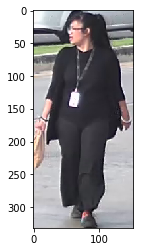

261 score: 0.997952461243


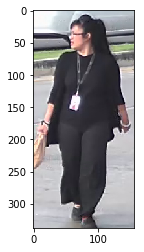

266 score: 0.998453736305


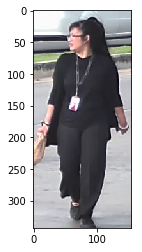

272 score: 0.998181819916


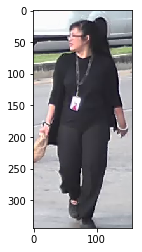

277 score: 0.997458875179


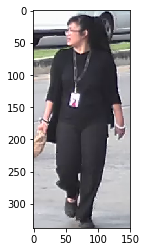

282 score: 0.99776828289


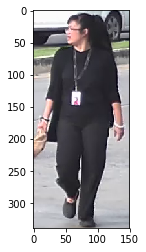

287 score: 0.998104572296


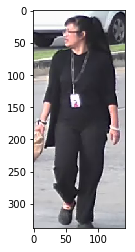

292 score: 0.998556673527


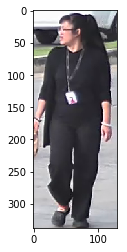

298 score: 0.998410820961


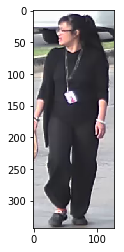

303 score: 0.998326838017


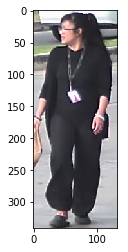

308 score: 0.99851256609


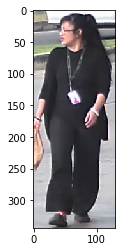

312 score: 0.998883187771


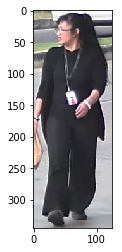

318 score: 0.998286664486


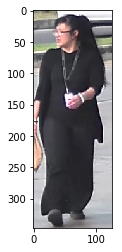

324 score: 0.997789502144


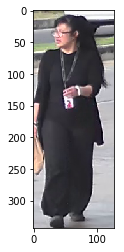

328 score: 0.997973144054


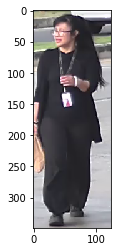

333 score: 0.998716711998


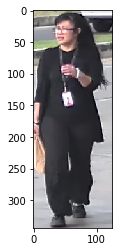

338 score: 0.998795390129


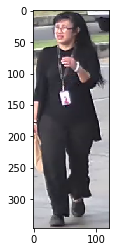

342 score: 0.999136149883


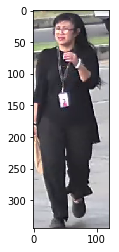

347 score: 0.999246478081


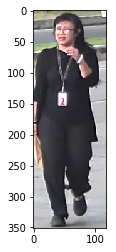

353 score: 0.998538732529


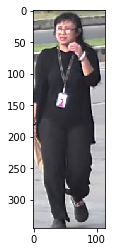

357 score: 0.998478114605


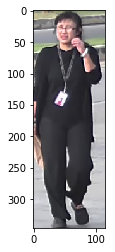

361 score: 0.998780786991


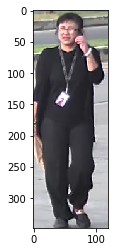

365 score: 0.999229073524


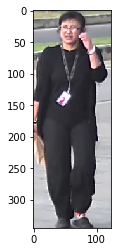

369 score: 0.999274909496


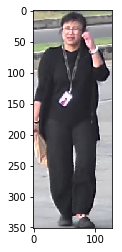

373 score: 0.999300956726


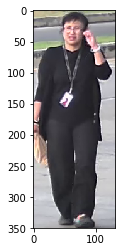

377 score: 0.999002277851


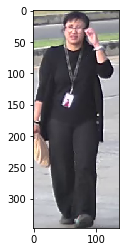

381 score: 0.99917691946


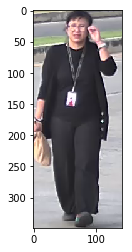

385 score: 0.999066054821


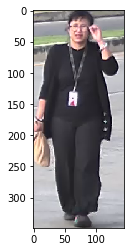

389 score: 0.999199211597


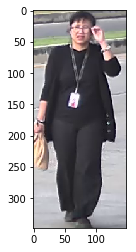

393 score: 0.999242424965


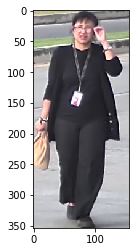

398 score: 0.999253690243


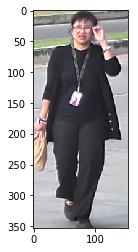

403 score: 0.99929702282


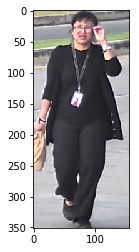

408 score: 0.999199569225


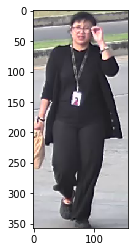

413 score: 0.999262034893


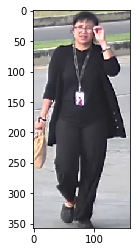

418 score: 0.99902844429


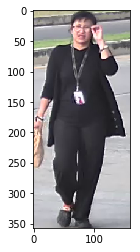

423 score: 0.998966574669


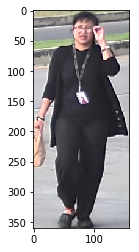

428 score: 0.999277055264


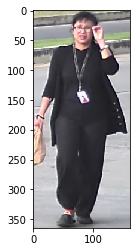

433 score: 0.999397158623


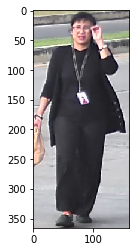

438 score: 0.99922311306


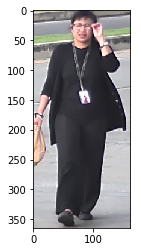

443 score: 0.998987972736


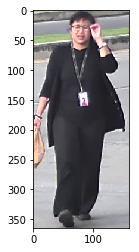

448 score: 0.998654484749


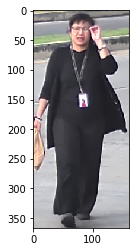

454 score: 0.99833881855


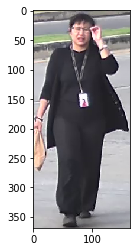

459 score: 0.998144626617


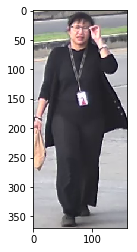

465 score: 0.997850298882


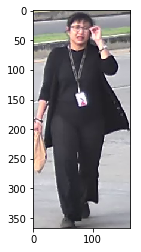

470 score: 0.998517453671


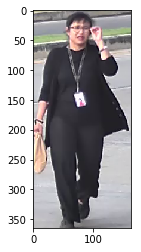

475 score: 0.99825745821


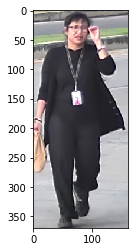

480 score: 0.99863666296


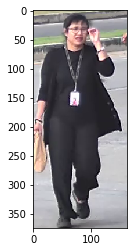

1 score: 0.998689115047


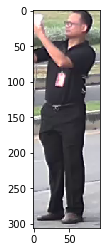

7 score: 0.998762011528


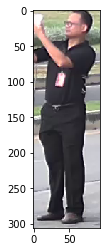

11 score: 0.998789608479


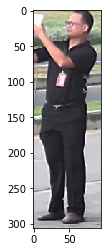

16 score: 0.99869030714


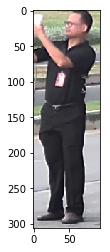

20 score: 0.998854756355


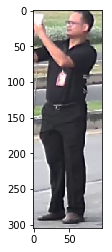

25 score: 0.998851537704


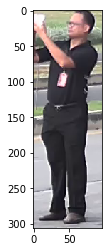

30 score: 0.998849272728


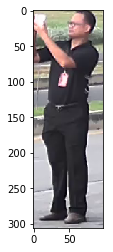

35 score: 0.998826682568


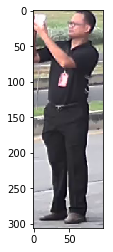

40 score: 0.998865008354


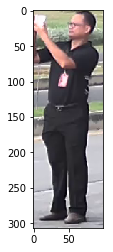

45 score: 0.998843431473


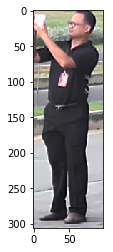

50 score: 0.998864889145


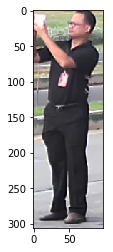

56 score: 0.998893916607


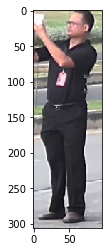

60 score: 0.999005734921


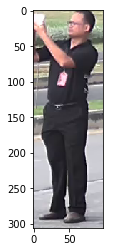

65 score: 0.999104440212


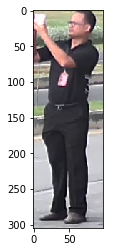

70 score: 0.999139428139


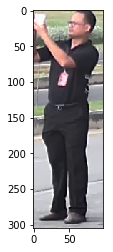

75 score: 0.999128639698


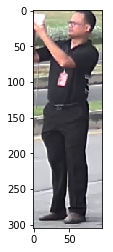

81 score: 0.999058902264


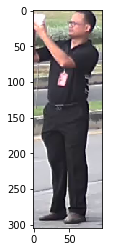

85 score: 0.999097824097


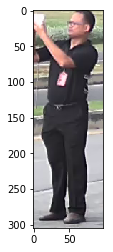

91 score: 0.99911159277


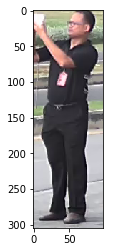

96 score: 0.999088168144


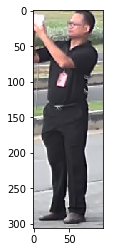

102 score: 0.999282300472


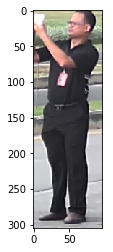

106 score: 0.999302864075


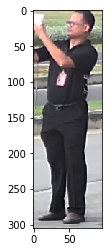

111 score: 0.999158382416


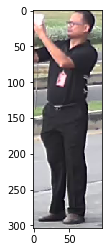

115 score: 0.999162793159


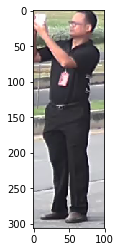

121 score: 0.999068558216


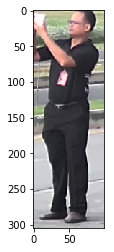

125 score: 0.99913918972


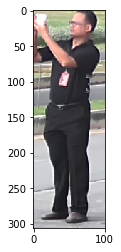

128 score: 0.99910992384


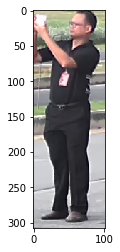

132 score: 0.999082565308


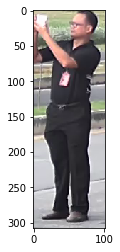

138 score: 0.999128043652


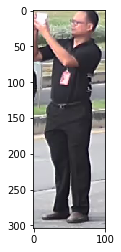

143 score: 0.998411178589


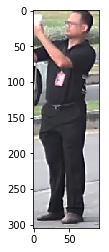

147 score: 0.998521149158


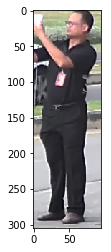

151 score: 0.998333871365


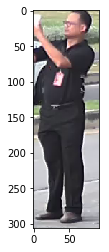

154 score: 0.998504638672


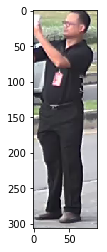

159 score: 0.998337388039


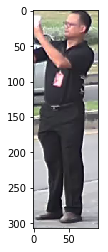

165 score: 0.998769581318


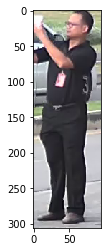

174 score: 0.996938943863


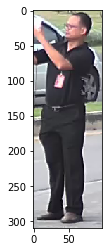

178 score: 0.997201323509


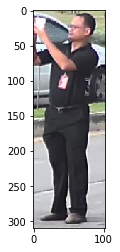

184 score: 0.996638417244


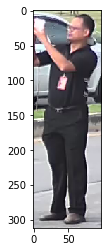

190 score: 0.996166110039


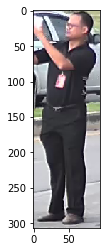

195 score: 0.991268754005


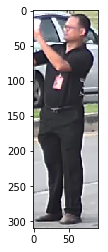

201 score: 0.991771399975


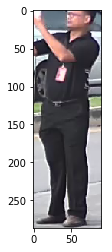

206 score: 0.993086636066


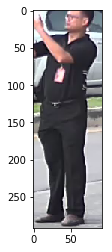

211 score: 0.996379196644


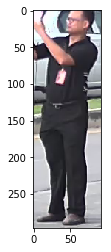

216 score: 0.996970653534


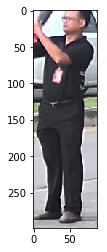

221 score: 0.994977891445


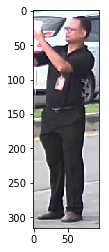

226 score: 0.995635926723


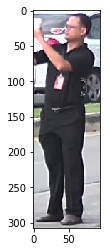

231 score: 0.99668854475


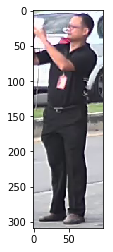

236 score: 0.986664891243


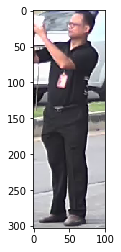

241 score: 0.991967141628


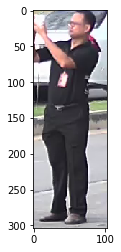

247 score: 0.981982588768


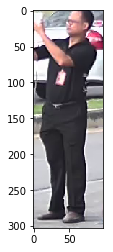

253 score: 0.988650560379


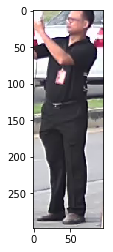

257 score: 0.996468067169


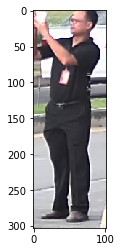

262 score: 0.996610462666


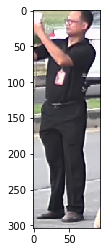

267 score: 0.998135685921


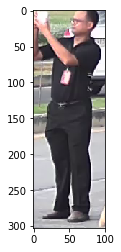

271 score: 0.998418569565


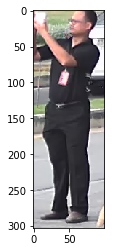

275 score: 0.99827671051


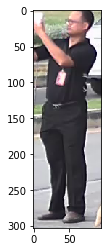

280 score: 0.998706698418


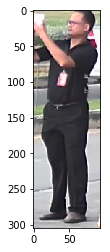

285 score: 0.998910784721


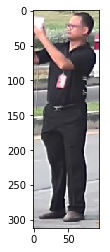

291 score: 0.998790919781


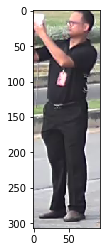

297 score: 0.998995125294


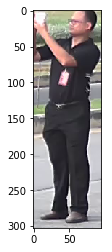

302 score: 0.998885810375


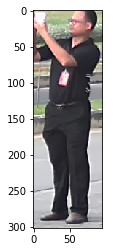

307 score: 0.998988807201


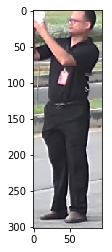

313 score: 0.998786151409


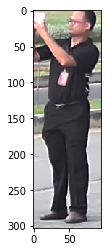

317 score: 0.998915553093


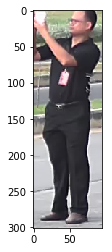

322 score: 0.998968362808


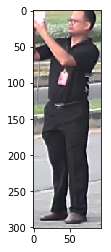

327 score: 0.999225616455


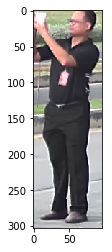

332 score: 0.999252855778


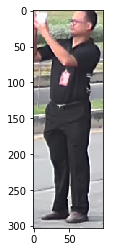

337 score: 0.999140262604


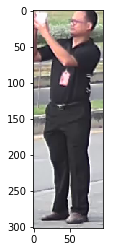

343 score: 0.999091506004


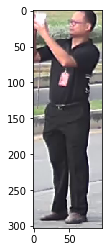

348 score: 0.999030351639


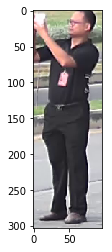

352 score: 0.998982131481


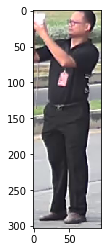

358 score: 0.998184263706


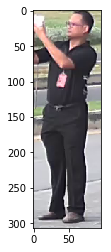

362 score: 0.998273134232


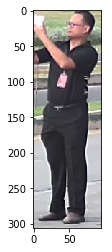

366 score: 0.997904539108


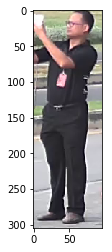

370 score: 0.997732877731


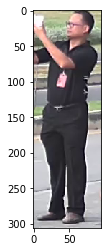

374 score: 0.997189342976


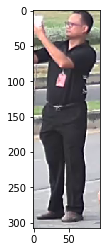

378 score: 0.996674895287


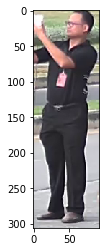

382 score: 0.997506201267


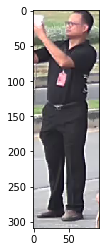

387 score: 0.997615695


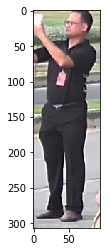

391 score: 0.996805548668


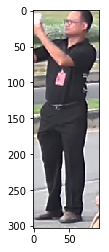

395 score: 0.996964514256


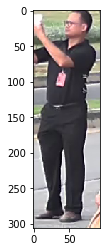

400 score: 0.996597588062


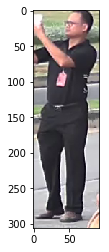

405 score: 0.996612489223


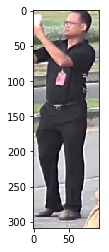

410 score: 0.997326493263


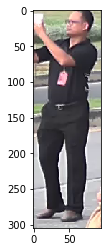

415 score: 0.997229874134


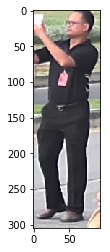

419 score: 0.997618257999


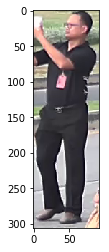

425 score: 0.996951341629


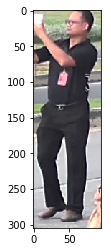

429 score: 0.997384250164


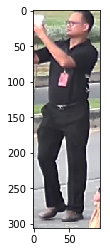

434 score: 0.997518658638


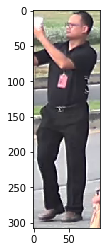

439 score: 0.998211741447


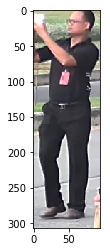

444 score: 0.99857544899


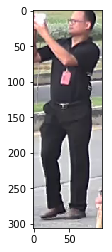

449 score: 0.99851924181


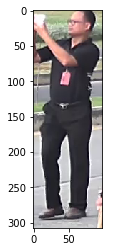

453 score: 0.999080777168


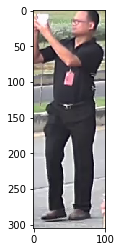

458 score: 0.999178230762


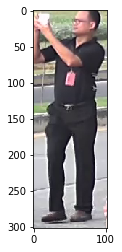

463 score: 0.999080657959


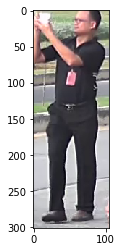

468 score: 0.9991081357


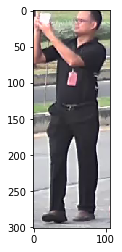

473 score: 0.999099969864


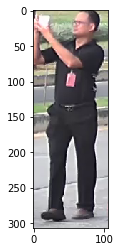

478 score: 0.999239206314


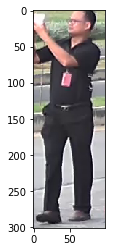

2 score: 0.998551547527


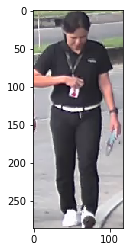

5 score: 0.998984992504


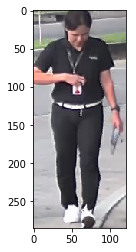

12 score: 0.998349070549


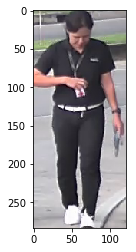

17 score: 0.998551189899


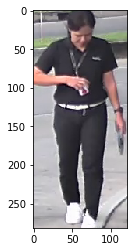

22 score: 0.998280286789


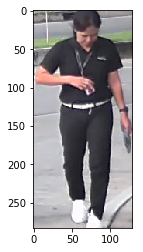

26 score: 0.998126089573


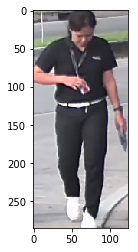

31 score: 0.998557984829


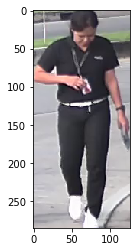

36 score: 0.998043775558


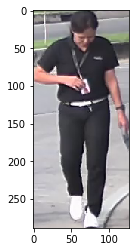

41 score: 0.998168110847


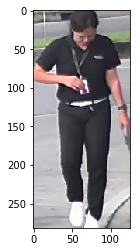

47 score: 0.998334944248


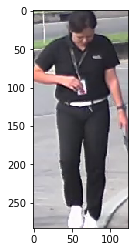

51 score: 0.998655080795


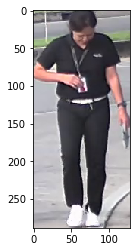

57 score: 0.997694790363


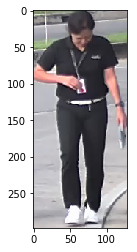

62 score: 0.998341917992


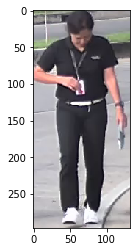

67 score: 0.998834788799


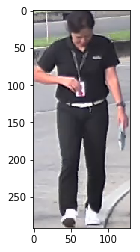

72 score: 0.998786270618


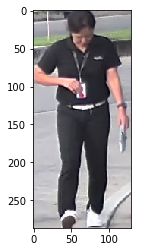

77 score: 0.998563826084


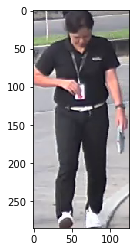

82 score: 0.998898625374


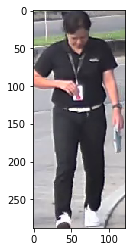

88 score: 0.998108386993


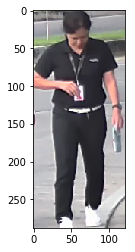

93 score: 0.998306155205


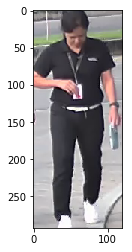

98 score: 0.998214364052


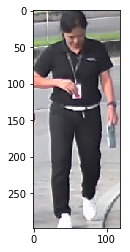

101 score: 0.99928611517


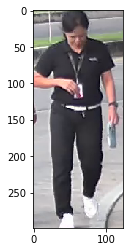

104 score: 0.999495863914


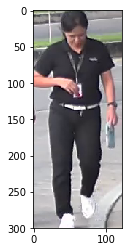

110 score: 0.999266684055


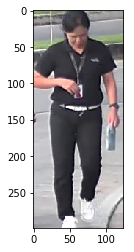

114 score: 0.999330878258


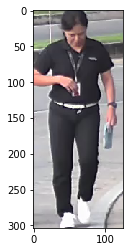

120 score: 0.99929857254


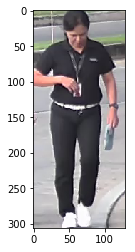

126 score: 0.998881042004


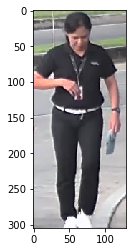

130 score: 0.999024748802


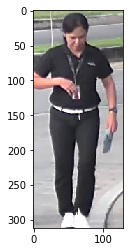

134 score: 0.998969912529


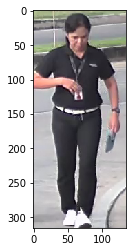

139 score: 0.99902009964


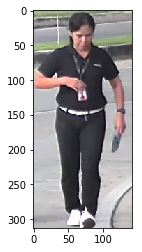

142 score: 0.999329924583


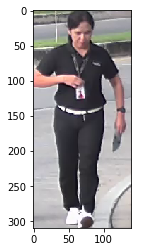

145 score: 0.999135792255


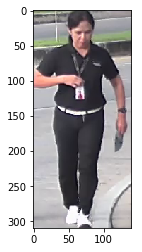

149 score: 0.999377071857


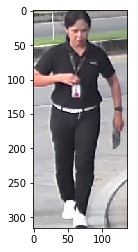

153 score: 0.999310016632


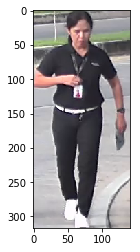

158 score: 0.998989999294


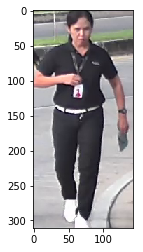

167 score: 0.997886955738


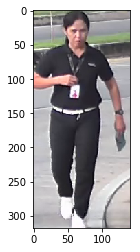

171 score: 0.998719096184


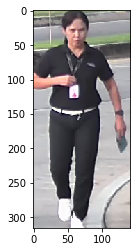

176 score: 0.999008357525


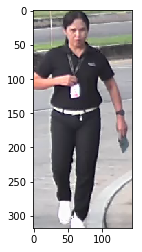

182 score: 0.99873906374


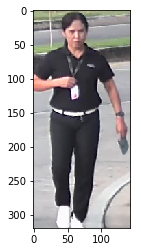

187 score: 0.999216914177


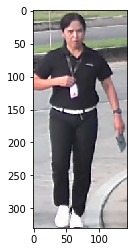

192 score: 0.998943984509


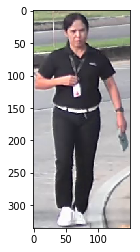

198 score: 0.999081373215


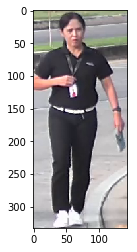

203 score: 0.999055325985


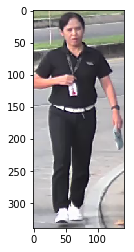

208 score: 0.999190270901


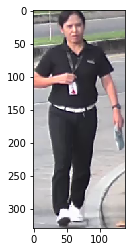

213 score: 0.999110639095


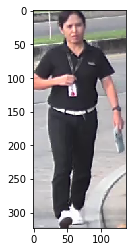

218 score: 0.999233603477


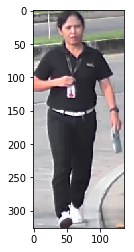

223 score: 0.99921631813


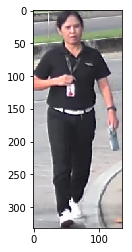

228 score: 0.999063909054


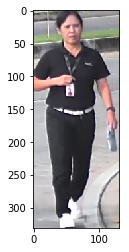

233 score: 0.999038696289


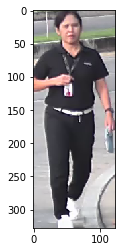

238 score: 0.999132931232


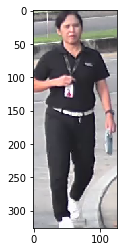

244 score: 0.998741686344


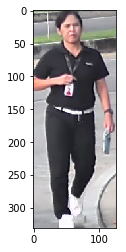

250 score: 0.998622179031


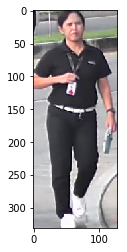

255 score: 0.998881161213


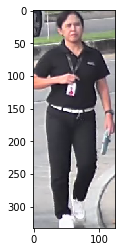

260 score: 0.998943030834


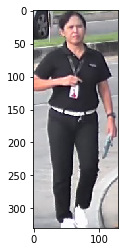

265 score: 0.998823940754


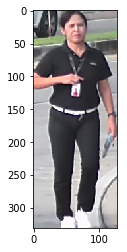

270 score: 0.998704195023


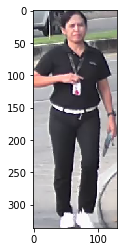

276 score: 0.997789144516


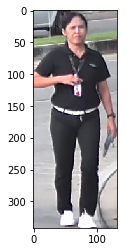

281 score: 0.998399913311


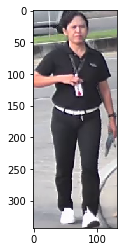

286 score: 0.998229086399


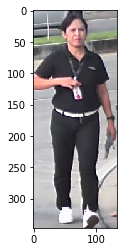

293 score: 0.998085379601


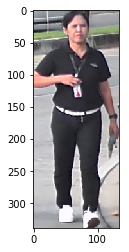

299 score: 0.997414708138


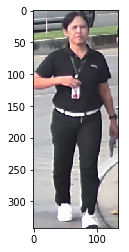

304 score: 0.997602760792


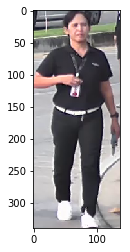

309 score: 0.997195601463


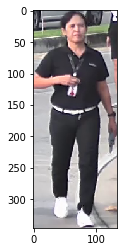

314 score: 0.998133003712


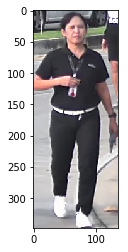

319 score: 0.997936487198


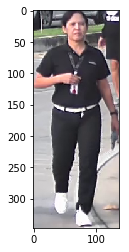

323 score: 0.998243331909


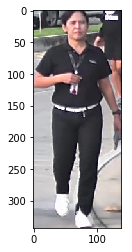

329 score: 0.995080709457


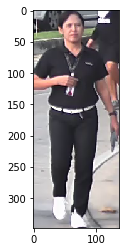

334 score: 0.996348083019


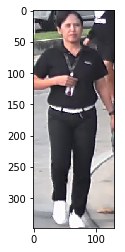

339 score: 0.99608540535


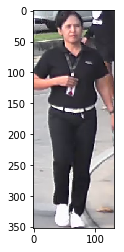

344 score: 0.995065271854


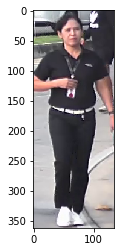

349 score: 0.995359241962


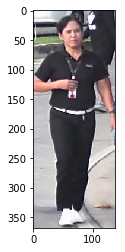

354 score: 0.997364699841


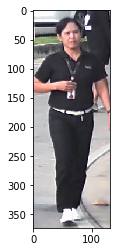

359 score: 0.995582401752


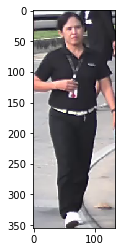

363 score: 0.995902240276


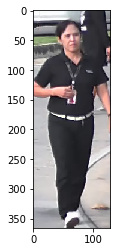

367 score: 0.99458271265


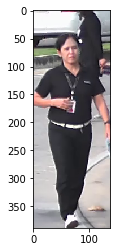

371 score: 0.993551135063


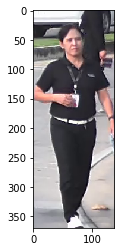

375 score: 0.994024217129


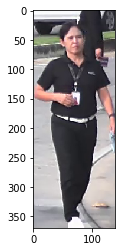

379 score: 0.995962440968


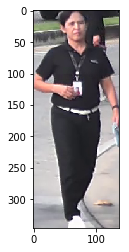

383 score: 0.996715664864


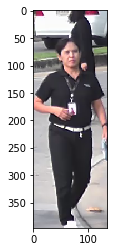

386 score: 0.997652232647


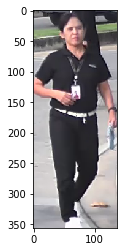

390 score: 0.998104333878


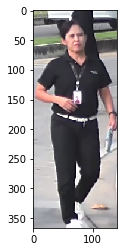

394 score: 0.999055445194


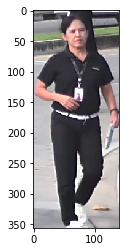

399 score: 0.998546004295


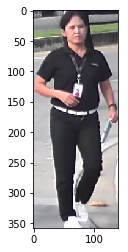

404 score: 0.998279213905


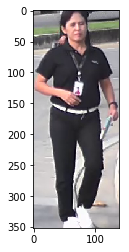

409 score: 0.998379707336


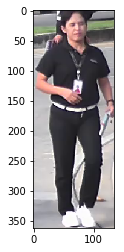

414 score: 0.997851252556


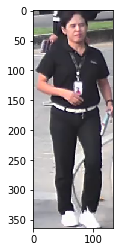

420 score: 0.996191382408


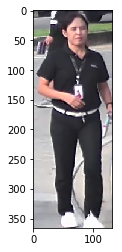

424 score: 0.997670710087


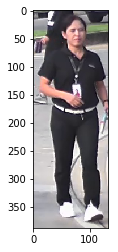

430 score: 0.996578991413


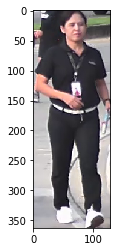

435 score: 0.996969521046


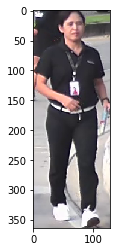

440 score: 0.998109102249


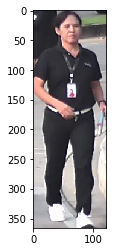

445 score: 0.998387098312


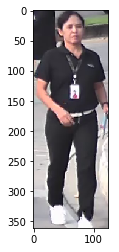

450 score: 0.998302459717


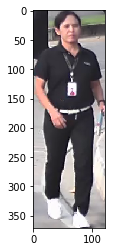

455 score: 0.996808826923


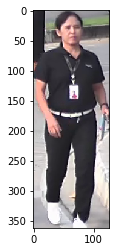

460 score: 0.997012138367


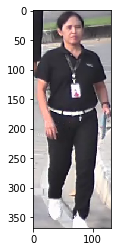

464 score: 0.998040735722


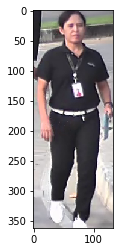

469 score: 0.998829782009


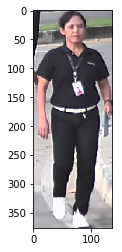

474 score: 0.998872101307


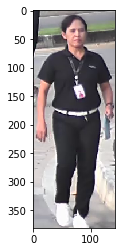

479 score: 0.998881518841


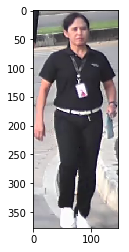

2 score: 0.998551547527


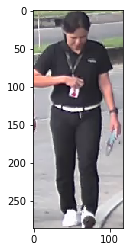

5 score: 0.998984992504


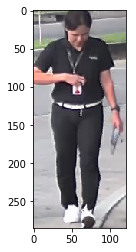

12 score: 0.998349070549


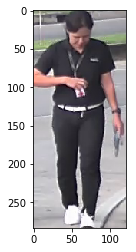

17 score: 0.998551189899


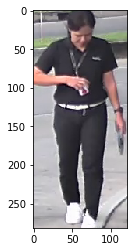

22 score: 0.998280286789


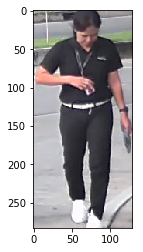

26 score: 0.998126089573


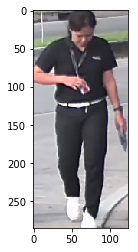

31 score: 0.998557984829


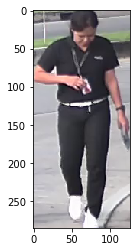

36 score: 0.998043775558


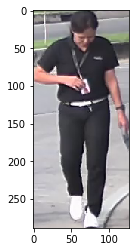

41 score: 0.998168110847


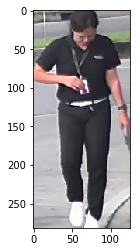

47 score: 0.998334944248


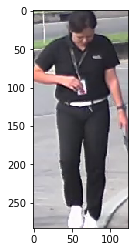

51 score: 0.998655080795


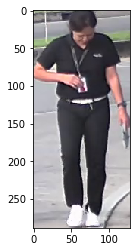

57 score: 0.997694790363


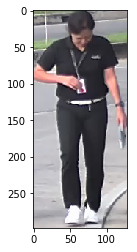

62 score: 0.998341917992


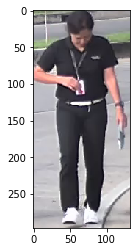

67 score: 0.998834788799


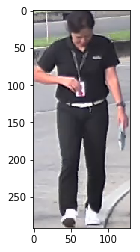

72 score: 0.998786270618


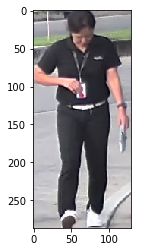

77 score: 0.998563826084


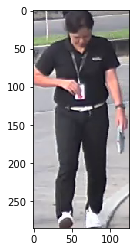

82 score: 0.998898625374


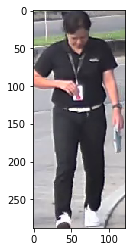

88 score: 0.998108386993


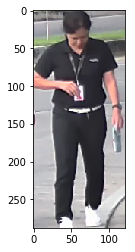

93 score: 0.998306155205


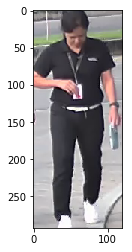

98 score: 0.998214364052


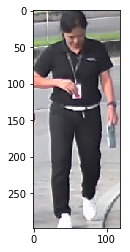

101 score: 0.99928611517


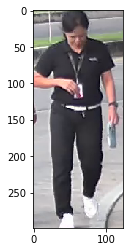

104 score: 0.999495863914


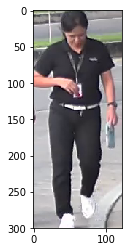

110 score: 0.999266684055


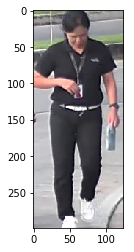

114 score: 0.999330878258


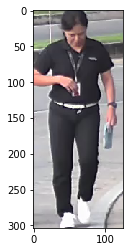

120 score: 0.99929857254


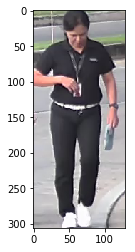

126 score: 0.998881042004


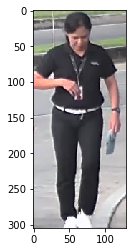

130 score: 0.999024748802


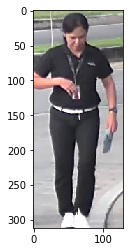

134 score: 0.998969912529


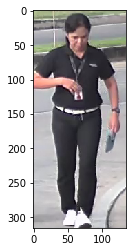

139 score: 0.99902009964


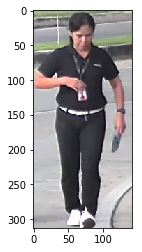

142 score: 0.999329924583


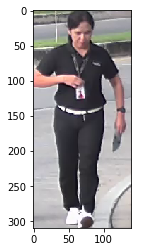

145 score: 0.999135792255


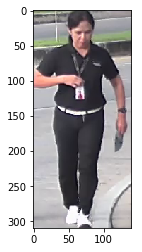

149 score: 0.999377071857


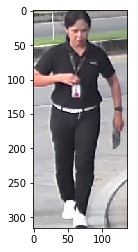

153 score: 0.999310016632


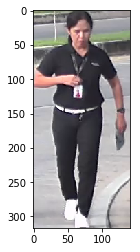

158 score: 0.998989999294


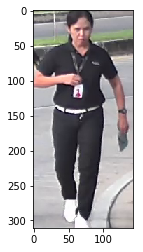

167 score: 0.997886955738


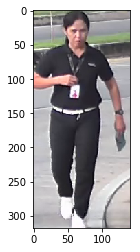

171 score: 0.998719096184


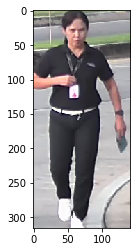

176 score: 0.999008357525


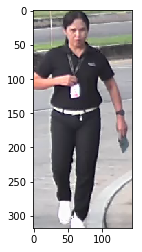

182 score: 0.99873906374


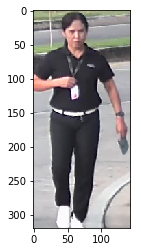

187 score: 0.999216914177


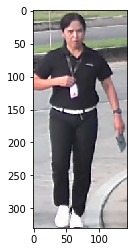

197 score: 0.790339648724


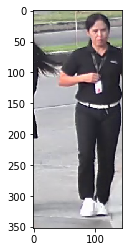

3 score: 0.962881267071


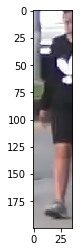

8 score: 0.974267065525


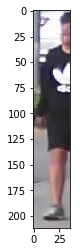

13 score: 0.977472364902


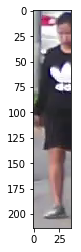

18 score: 0.98391276598


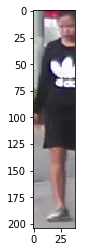

23 score: 0.988120794296


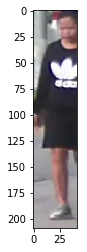

28 score: 0.994392633438


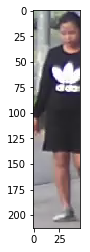

33 score: 0.994957268238


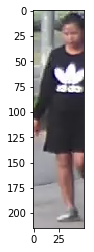

38 score: 0.99614918232


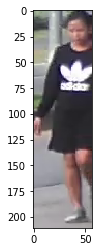

43 score: 0.99654006958


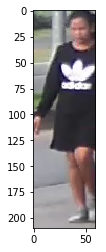

48 score: 0.996770501137


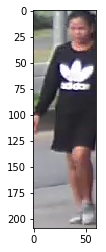

53 score: 0.995636284351


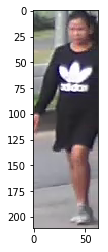

58 score: 0.996169745922


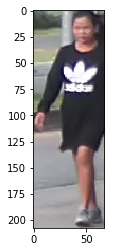

63 score: 0.997394680977


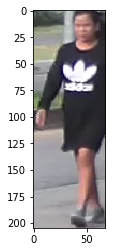

68 score: 0.998130619526


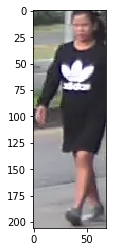

73 score: 0.997329831123


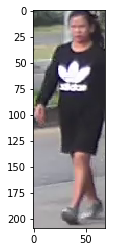

78 score: 0.997331619263


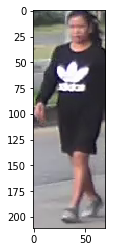

83 score: 0.997953057289


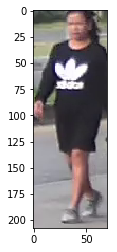

87 score: 0.998695313931


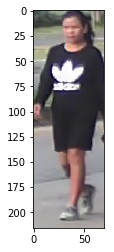

92 score: 0.99881196022


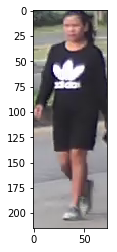

97 score: 0.998845338821


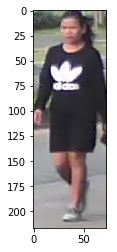

103 score: 0.999039709568


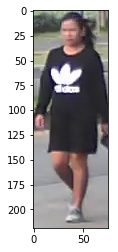

107 score: 0.999036073685


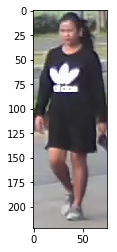

112 score: 0.998145461082


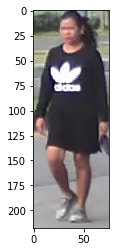

117 score: 0.997985124588


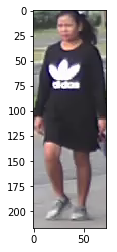

123 score: 0.998138070107


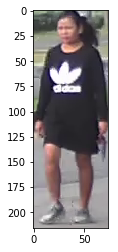

127 score: 0.998125493526


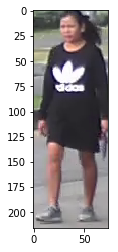

131 score: 0.998545527458


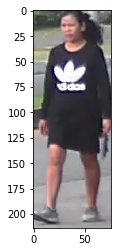

135 score: 0.997925877571


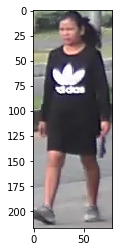

140 score: 0.997976601124


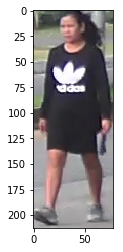

144 score: 0.998153865337


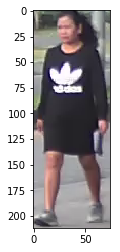

148 score: 0.997614979744


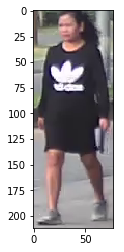

152 score: 0.998322308064


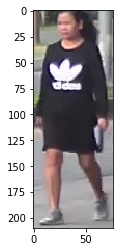

155 score: 0.998451352119


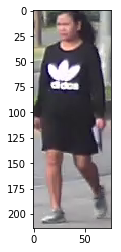

160 score: 0.998299896717


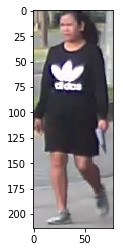

166 score: 0.99813336134


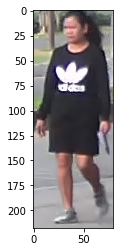

172 score: 0.99779343605


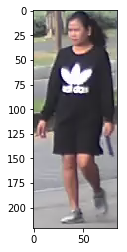

177 score: 0.998609781265


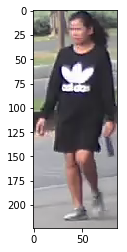

183 score: 0.998633682728


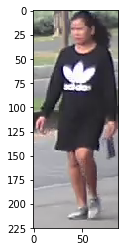

188 score: 0.998256266117


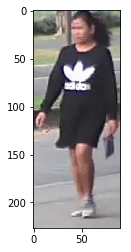

194 score: 0.997521936893


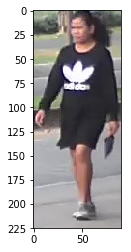

200 score: 0.996203362942


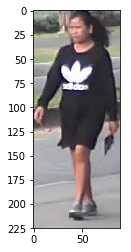

204 score: 0.997963428497


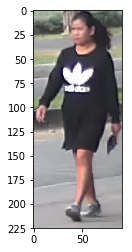

210 score: 0.997546613216


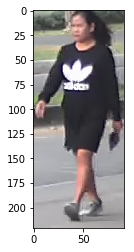

215 score: 0.998517096043


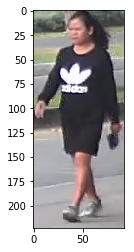

220 score: 0.99860137701


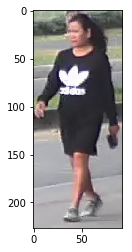

225 score: 0.99840503931


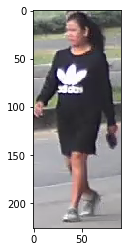

230 score: 0.998295605183


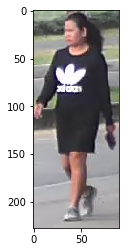

235 score: 0.995876908302


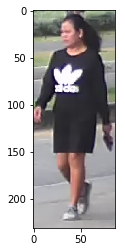

240 score: 0.995351314545


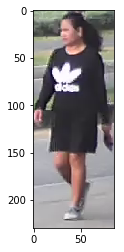

246 score: 0.995606005192


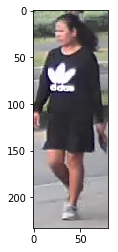

252 score: 0.994925618172


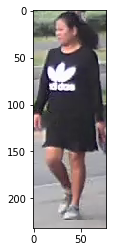

258 score: 0.996185362339


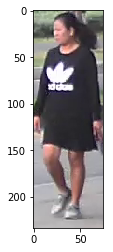

263 score: 0.996198356152


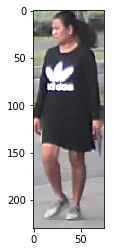

268 score: 0.997437238693


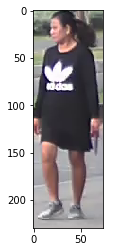

273 score: 0.993390202522


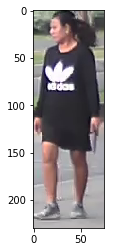

278 score: 0.993446528912


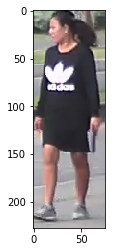

283 score: 0.989454388618


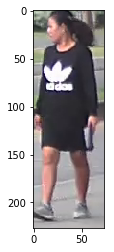

288 score: 0.989241063595


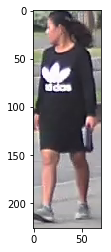

294 score: 0.991230607033


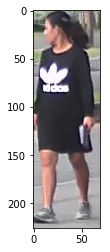

300 score: 0.994764089584


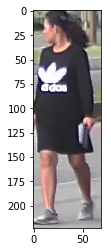

305 score: 0.993738651276


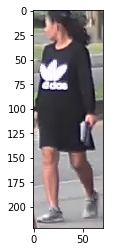

310 score: 0.990774810314


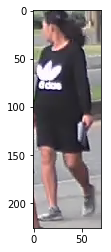

315 score: 0.984245240688


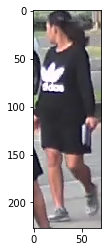

321 score: 0.96569609642


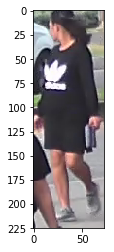

326 score: 0.961034536362


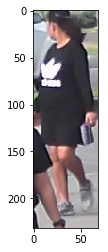

331 score: 0.916071951389


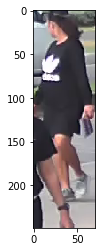

335 score: 0.969696879387


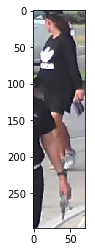

340 score: 0.971539497375


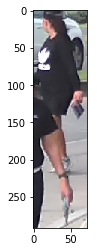

346 score: 0.817709982395


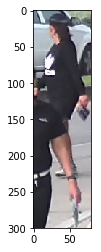

351 score: 0.723587870598


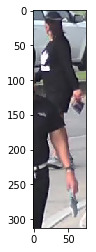

356 score: 0.866356730461


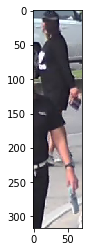

4 score: 0.942687451839


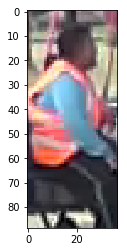

9 score: 0.965768814087


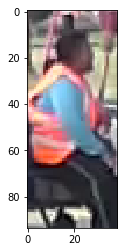

14 score: 0.955329418182


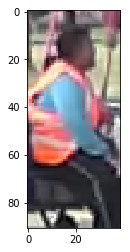

19 score: 0.967267632484


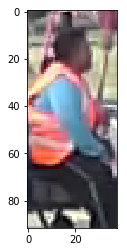

24 score: 0.950058400631


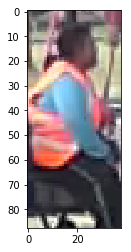

29 score: 0.960211455822


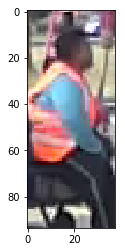

34 score: 0.963232398033


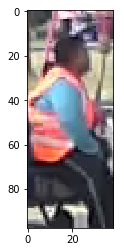

39 score: 0.975437343121


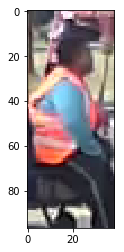

44 score: 0.942346870899


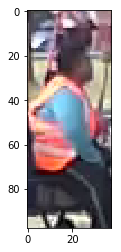

49 score: 0.953456640244


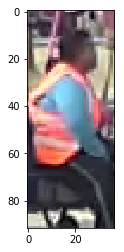

54 score: 0.911095678806


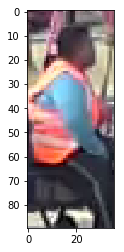

59 score: 0.951367974281


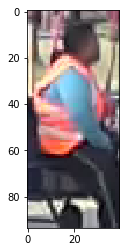

64 score: 0.956494927406


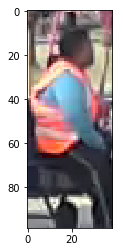

69 score: 0.958187878132


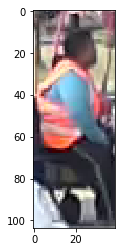

74 score: 0.968024373055


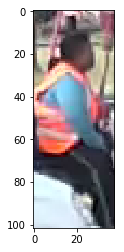

79 score: 0.950771331787


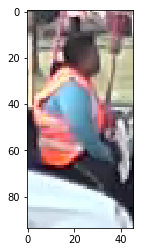

84 score: 0.972715377808


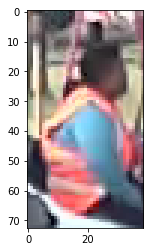

89 score: 0.939126133919


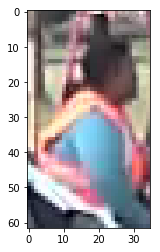

94 score: 0.945478618145


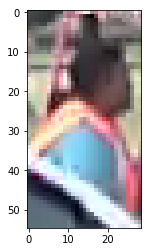

99 score: 0.820777833462


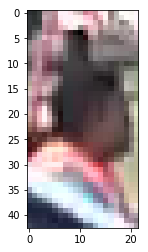

108 score: 0.788309574127


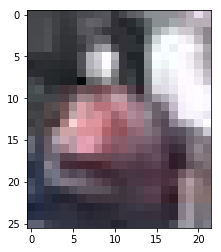

113 score: 0.740398585796


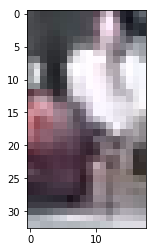

118 score: 0.827237427235


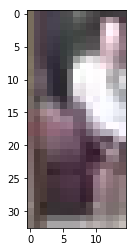

136 score: 0.775673091412


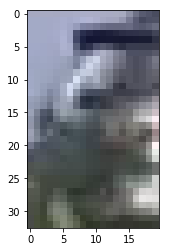

157 score: 0.777721464634


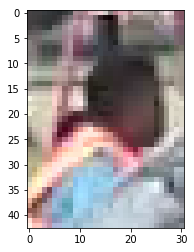

163 score: 0.84195458889


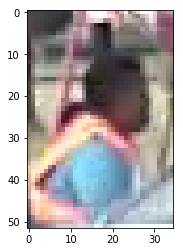

170 score: 0.712385296822


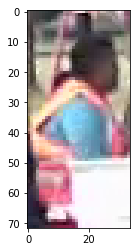

175 score: 0.813939988613


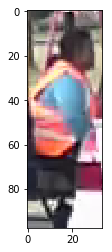

180 score: 0.838568031788


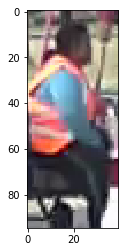

186 score: 0.859627962112


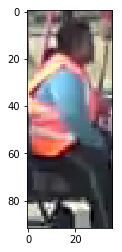

191 score: 0.872454762459


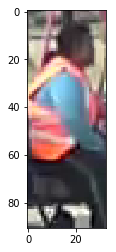

196 score: 0.941755712032


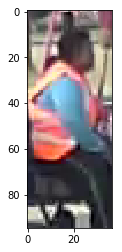

202 score: 0.955823361874


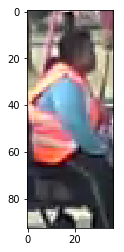

207 score: 0.973841488361


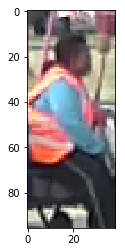

212 score: 0.968507647514


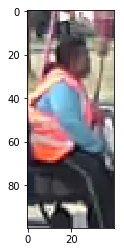

217 score: 0.979782283306


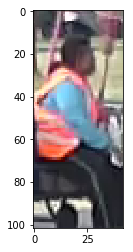

222 score: 0.974745810032


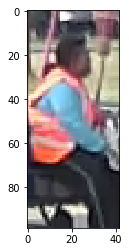

227 score: 0.962474703789


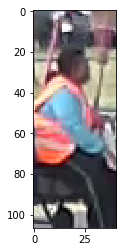

232 score: 0.947969198227


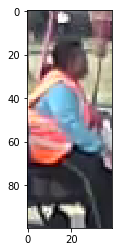

237 score: 0.901126861572


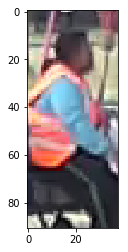

242 score: 0.944112122059


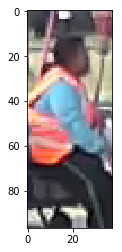

248 score: 0.933550477028


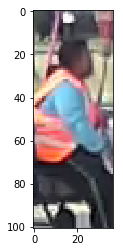

254 score: 0.93923330307


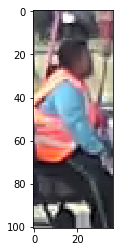

259 score: 0.939177334309


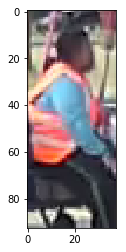

264 score: 0.952982366085


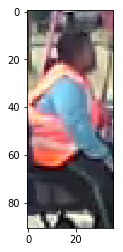

269 score: 0.952724635601


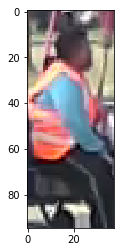

274 score: 0.949227154255


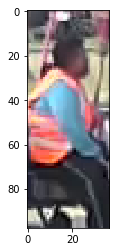

279 score: 0.939452826977


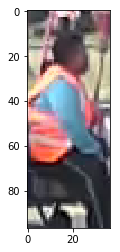

284 score: 0.948934435844


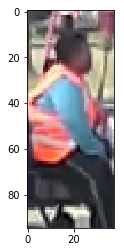

289 score: 0.957973182201


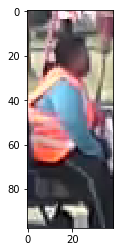

295 score: 0.967114806175


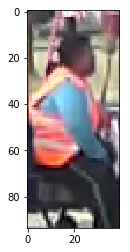

301 score: 0.976455271244


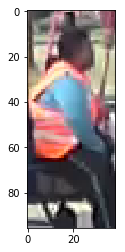

306 score: 0.977625787258


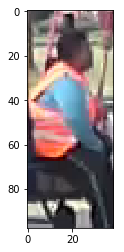

311 score: 0.981228172779


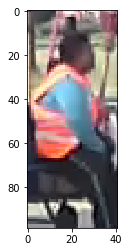

316 score: 0.967111349106


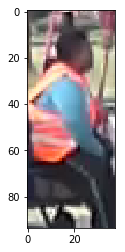

320 score: 0.96689748764


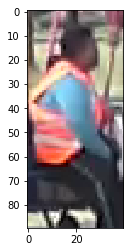

325 score: 0.969140529633


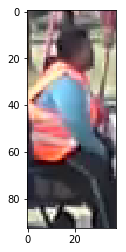

330 score: 0.953339517117


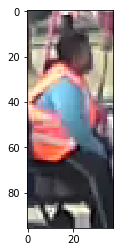

336 score: 0.958021104336


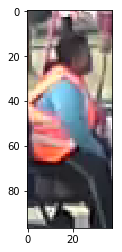

341 score: 0.960428893566


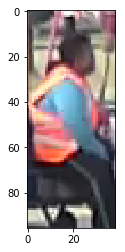

345 score: 0.964183747768


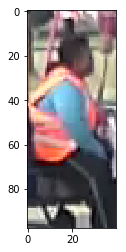

350 score: 0.958380401134


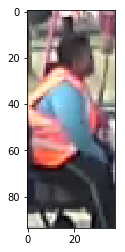

355 score: 0.962243318558


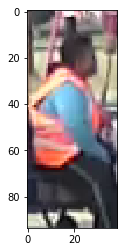

360 score: 0.951239228249


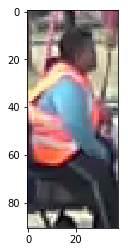

364 score: 0.95016849041


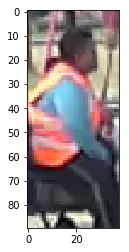

368 score: 0.965402364731


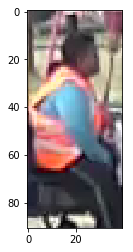

372 score: 0.96360129118


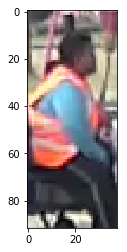

376 score: 0.965050399303


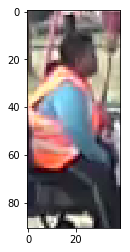

380 score: 0.96936583519


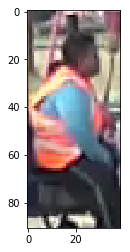

384 score: 0.948615431786


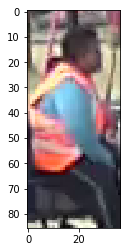

388 score: 0.948550283909


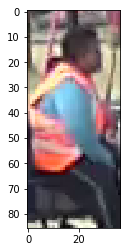

392 score: 0.94691067934


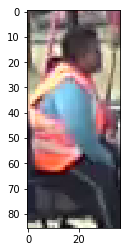

396 score: 0.95023971796


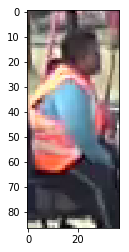

401 score: 0.95877379179


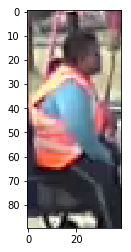

406 score: 0.959367513657


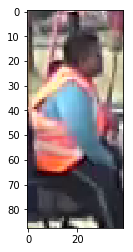

411 score: 0.958204507828


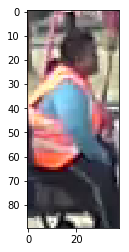

416 score: 0.957637786865


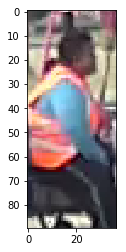

421 score: 0.952087283134


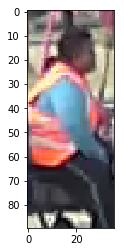

426 score: 0.953526139259


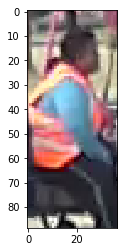

431 score: 0.960051894188


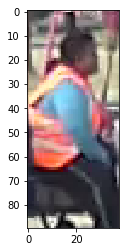

437 score: 0.962327063084


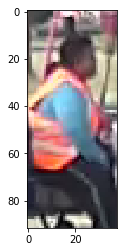

442 score: 0.972963273525


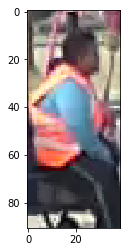

446 score: 0.973306775093


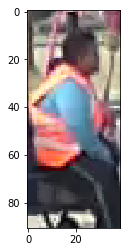

452 score: 0.973692715168


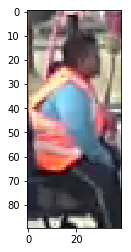

457 score: 0.971759855747


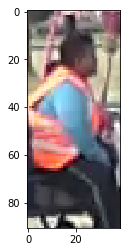

462 score: 0.971185863018


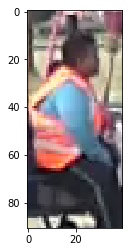

467 score: 0.973059773445


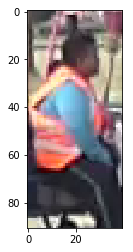

472 score: 0.966261982918


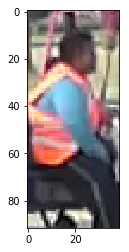

477 score: 0.96433109045


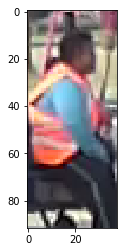

482 score: 0.963343918324


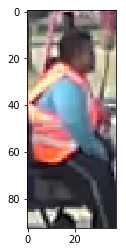

157 score: 0.777721464634


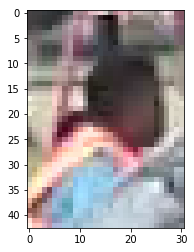

164 score: 0.705707907677


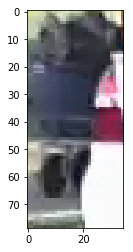

169 score: 0.842427492142


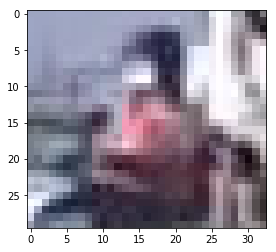

181 score: 0.718552827835


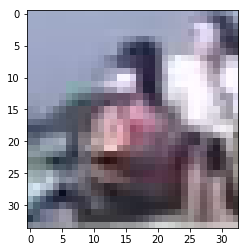

243 score: 0.72519916296


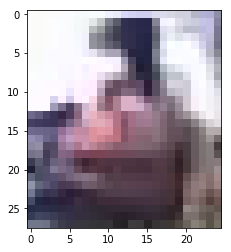

249 score: 0.86581838131


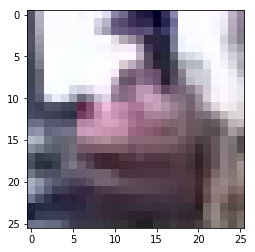

290 score: 0.755748569965


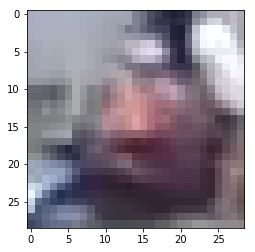

296 score: 0.744004607201


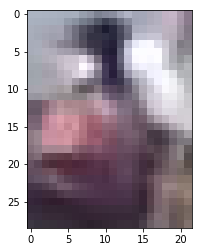

397 score: 0.798656105995


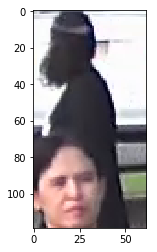

402 score: 0.720438957214


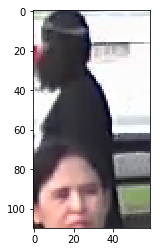

407 score: 0.799023211002


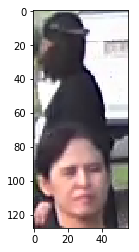

412 score: 0.835472106934


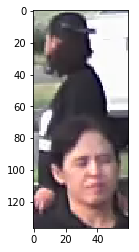

417 score: 0.724771022797


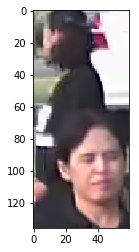

422 score: 0.894683718681


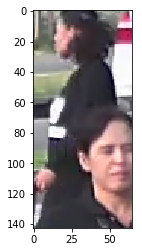

427 score: 0.940230548382


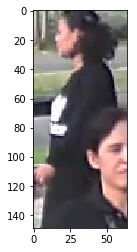

432 score: 0.933263361454


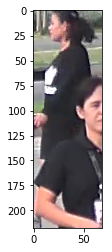

436 score: 0.98063570261


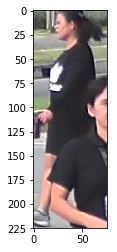

441 score: 0.985365092754


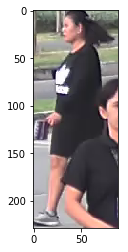

447 score: 0.966618835926


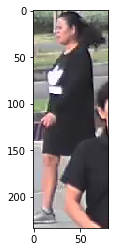

451 score: 0.985563158989


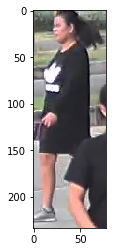

456 score: 0.994276821613


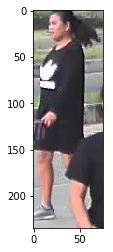

461 score: 0.994536399841


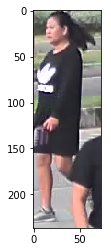

466 score: 0.995920300484


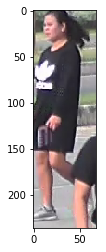

471 score: 0.993166863918


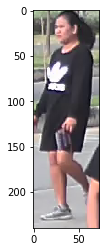

476 score: 0.996931910515


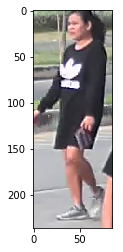

481 score: 0.998286068439


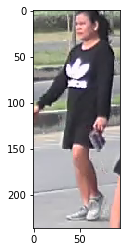

In [33]:
visualize_all(paths, df_points)

Total Objects: 15
[  0   5   1   3   4 169 397 108 157 136 290 243 181 164]
14
ID: 0 	score: 0.999021172523


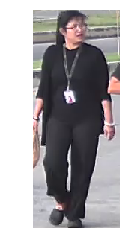

ID: 5 	score: 0.998984992504


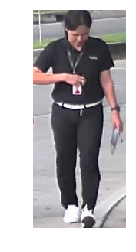

ID: 1 	score: 0.998689115047


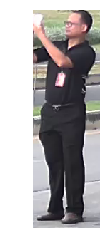

ID: 3 	score: 0.962881267071


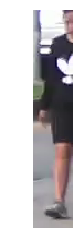

ID: 4 	score: 0.942687451839


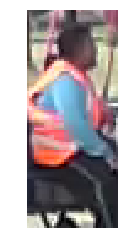

ID: 169 	score: 0.842427492142


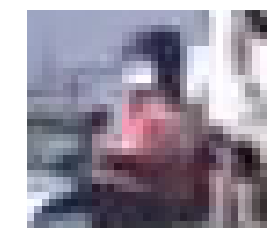

ID: 397 	score: 0.798656105995


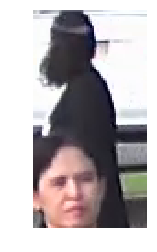

ID: 108 	score: 0.788309574127


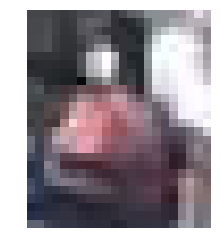

ID: 157 	score: 0.777721464634


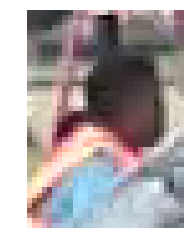

ID: 136 	score: 0.775673091412


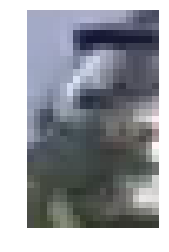

ID: 290 	score: 0.755748569965


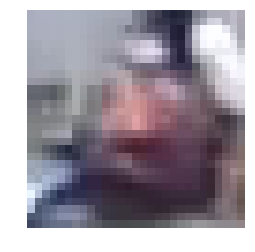

ID: 243 	score: 0.72519916296


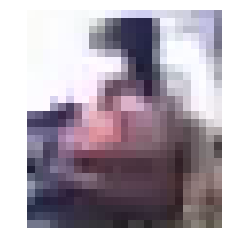

ID: 181 	score: 0.718552827835


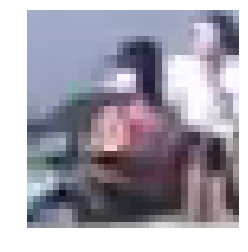

ID: 164 	score: 0.705707907677


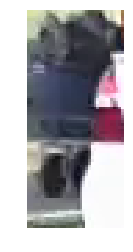

In [43]:
visualize_selected(paths, df_points, directory = '../data/5_BEST/')

In [34]:
Xs, Ys, Zs = [], [], []
for ind in points_objs:
    x, y = points_objs[ind]['center'] 
    z = points_objs[ind]['frame']
    Xs.append(x)
    Ys.append(y)
    Zs.append(z)

In [1]:
trace1 = go.Scatter3d(
    x=Xs,
    y=Ys,
    z=Zs,
    mode='markers',
    marker=dict(
        size=6,
        color=Zs,                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)

data = [trace1]
layout = go.Layout(
    height=1000,
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    )
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

NameError: name 'go' is not defined